In [2]:
!pip install bertopic

# Section One: Model training and Hyperparamter tuning


In [3]:
!pip install optuna

In [4]:
!pip install numpy==1.26.4 gensim==4.3.3


In [5]:
import os

current_working_directory = os.getcwd()
current_working_directory

'/home3/nkcb64/Create Jupyter Environment Script'

In [6]:
# Load data 
import pandas as pd
df = pd.read_csv('cleaned_wiredbert.csv')

In [7]:
docs = df['text_content']
docs = [doc if doc is not None and not (isinstance(doc, float) and np.isnan(doc)) else "" for doc in docs]
docs = [str(doc) for doc in docs]
non_string_elements = [doc for doc in docs if not isinstance(doc, str)]
if non_string_elements:
    print("Non-string elements found:", non_string_elements)
    

In [8]:
!pip install scikit-learn

In [9]:
!pip install spacy

In [11]:
import spacy

In [12]:
!pip install plotly kaleido


In [13]:
!pip install -U kaleido


Requirement already up-to-date: kaleido in /home3/nkcb64/myjupyterenv/lib/python3.9/site-packages (0.2.1)


In [ ]:
# Run default out of the box bertopic model
from bertopic import BERTopic

defaultmodel = BERTopic()
topics, probs = defaultmodel.fit_transform(docs)


In [35]:
defaultmodel.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,11855,-1_and_of_the_to,"[and, of, the, to, in, is, for, that, with, on]",[Follow the MoneyCooling the Net Hype IIIn Wir...
1,0,601,0_index_stocks_dow_points,"[index, stocks, dow, points, rose, fell, nasda...",[NEW YORK -- An unexpected interest rate cut a...
2,1,504,1_microsoft_antitrust_justice_jackson,"[microsoft, antitrust, justice, jackson, court...",[TAIPEI -- Microsoft chairman Bill Gates said ...
3,2,354,2_game_games_gaming_players,"[game, games, gaming, players, gamers, quake, ...",[Computer games appear to be stuck in a shoot-...
4,3,334,3_book_science_human_his,"[book, science, human, his, novel, intelligenc...",[On the bookshelves of the digeratiJANICE GJER...
...,...,...,...,...,...
471,470,10,470_crypto_cryptonomicon_cypherpunk_boire,"[crypto, cryptonomicon, cypherpunk, boire, sen...",[In 1992 Neal Stephenson defined virtual reali...
472,471,10,471_walmart_boycott_culture_apology,"[walmart, boycott, culture, apology, freedom, ...","[""Mr. Apology"" was quite the shoplifter. Being..."
473,472,10,472_wriston_wristons_money_walter,"[wriston, wristons, money, walter, citibank, b...","[""I don't want to make money. I just want to b..."
474,473,10,473_yahoo_geocities_broadcastcom_acquisition,"[yahoo, geocities, broadcastcom, acquisition, ...","[A year from now, Web surfers will expect a mu..."


In [23]:
from gensim.models import CoherenceModel
from gensim import corpora

vectorizer = multi_topic_model.vectorizer_model
analyzer = vectorizer.build_analyzer()

# Function to calculate topic coherence_npmi 


words = vectorizer.get_feature_names_out()
tokens = [analyzer(doc) for doc in docs]
dictionary = corpora.Dictionary(tokens)
corpus = [dictionary.doc2bow(token) for token in tokens]
topic_words = []
for topic_num in range(len(multi_topic_model.get_topics())):
    topic = multi_topic_model.get_topic(topic_num)
    if topic:  # Ensure the topic is not empty or invalid
        topic_words.append([word for word, _ in topic])

In [25]:
coherence_model = CoherenceModel(topics=topic_words, 
                                 texts=tokens, 
                                 corpus=corpus,
                                 dictionary=dictionary, 
                                 coherence='u_mass')

# Step 7: Calculate the NPMI coherence score
coherence = coherence_model.get_coherence()

#print(f"NPMI Coherence Score: {coherence}")

NPMI Coherence Score: -2.004759400598533


In [12]:
from transformers import BertTokenizer
from sentence_transformers import SentenceTransformer

# Try models with longer maximum sequence length than the default 

models = [
    {
        'name': 'distilbert-base-cased  (512 tokens)',
        'tokenizer': BertTokenizer.from_pretrained('distilbert-base-cased'),
        'max_seq_length': 512
    },
    {
        'name': 'BAAI/bge-base-en-v1.5 (512 tokens)',
        'tokenizer': SentenceTransformer('BAAI/bge-base-en-v1.5'),
        'max_seq_length': 512
    },
    {
        'name': 'all-MiniLM-L6-v2 (256 tokens)',
        'tokenizer': SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2'),
        'max_seq_length': 384
    }
]


The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'DistilBertTokenizer'. 
The class this function is called from is 'BertTokenizer'.


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [45]:
from sentence_transformers import SentenceTransformer

# Load the pre-trained  defualt model
model = SentenceTransformer('sentence-transformers/all-MiniLM-L6-v2')


/home3/nkcb64/myjupyterenv/lib/python3.9/site-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [46]:
tokenizer = model.tokenizer

max_seq_length = tokenizer.model_max_length
print(f"Maximum Sequence Length: {max_seq_length}")

# Initialize lists to store results
num_tokens_list = []
tokens_lost_list = []
percentage_lost_list = []

# Tokenize each document with built in tokenizer and calculate percentage loss for each document 
# Loop through each document in the list
for i, document in enumerate(docs):
    # Tokenize the document
    tokens = tokenizer.encode(document, truncation=False)

    # Calculate the number of tokens in the document
    num_tokens = len(tokens)
    num_tokens_list.append(num_tokens)

    # Check how many tokens are lost
    if num_tokens > max_seq_length:
        tokens_lost = num_tokens - max_seq_length
        percentage_lost = (tokens_lost / num_tokens) * 100
    else:
        tokens_lost = 0
        percentage_lost = 0.0

    tokens_lost_list.append(tokens_lost)
    percentage_lost_list.append(percentage_lost)

Token indices sequence length is longer than the specified maximum sequence length for this model (281 > 256). Running this sequence through the model will result in indexing errors


Maximum Sequence Length: 256


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


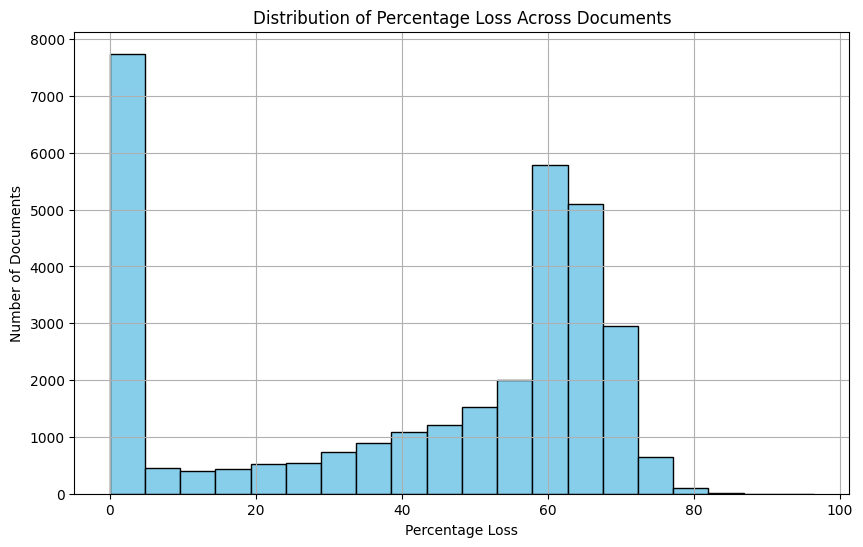

In [47]:
!pip install matplotlib

import matplotlib.pyplot as plt

# Plot percentage loss of documents 

# Create a histogram of percentage loss
plt.figure(figsize=(10, 6))
plt.hist(percentage_lost_list, bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Percentage Loss Across Documents')
plt.xlabel('Percentage Loss')
plt.ylabel('Number of Documents')
plt.grid(True)
plt.savefig('percentage_loss_distribution.png', dpi=300, bbox_inches='tight')

plt.show()

In [41]:
# Try second model 

model2 = SentenceTransformer('BAAI/bge-base-en-v1.5')

In [42]:
tokenizer = model2.tokenizer

max_seq_length = tokenizer.model_max_length
print(f"Maximum Sequence Length: {max_seq_length}")

# Initialize lists to store results
num_tokens_list = []
tokens_lost_list = []
percentage_lost_list = []

# Loop through each document in the list
for i, document in enumerate(docs):
    # Tokenize the document
    tokens = tokenizer.encode(document, truncation=False)

    # Calculate the number of tokens in the document
    num_tokens = len(tokens)
    num_tokens_list.append(num_tokens)

    # Check how many tokens are lost
    if num_tokens > max_seq_length:
        tokens_lost = num_tokens - max_seq_length
        percentage_lost = (tokens_lost / num_tokens) * 100
    else:
        tokens_lost = 0
        percentage_lost = 0.0

    tokens_lost_list.append(tokens_lost)
    percentage_lost_list.append(percentage_lost)

Token indices sequence length is longer than the specified maximum sequence length for this model (826 > 512). Running this sequence through the model will result in indexing errors


Maximum Sequence Length: 512


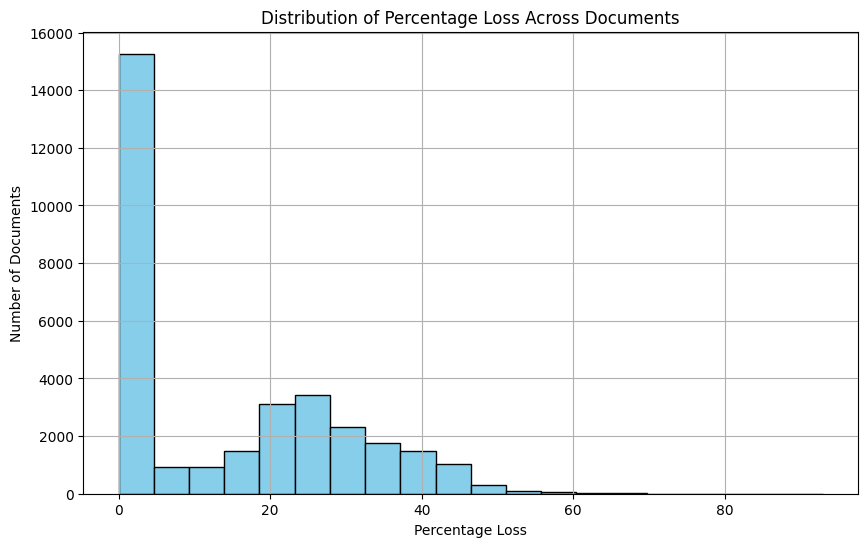

In [44]:
# Create a histogram of percentage loss
plt.figure(figsize=(10, 6))
plt.hist(percentage_lost_list, bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Percentage Loss Across Documents')
plt.xlabel('Percentage Loss')
plt.ylabel('Number of Documents')
plt.grid(True)
plt.savefig('percentage_loss_distribution_baii.png', dpi=300, bbox_inches='tight')

plt.show()

In [28]:
tokenizer2 = model2.tokenizer

# Check the maximum sequence length
max_seq_length = tokenizer2.model_max_length

print(f"Maximum Sequence Length: {max_seq_length}")


Maximum Sequence Length: 512


In [48]:
model2



SentenceTransformer(
  (0): Transformer({'max_seq_length': 512, 'do_lower_case': True}) with Transformer model: BertModel 
  (1): Pooling({'word_embedding_dimension': 768, 'pooling_mode_cls_token': True, 'pooling_mode_mean_tokens': False, 'pooling_mode_max_tokens': False, 'pooling_mode_mean_sqrt_len_tokens': False, 'pooling_mode_weightedmean_tokens': False, 'pooling_mode_lasttoken': False, 'include_prompt': True})
  (2): Normalize()
)

In [31]:
model

SentenceTransformer(
  (0): Transformer({'max_seq_length': 512, 'do_lower_case': False}) with Transformer model: RobertaModel 
  (1): Pooling({'word_embedding_dimension': 768, 'pooling_mode_cls_token': False, 'pooling_mode_mean_tokens': True, 'pooling_mode_max_tokens': False, 'pooling_mode_mean_sqrt_len_tokens': False, 'pooling_mode_weightedmean_tokens': False, 'pooling_mode_lasttoken': False, 'include_prompt': True})
  (2): Normalize()
)

In [52]:
# Third model (transformer but not sentence transformer model)

model3 = SentenceTransformer('sentence-transformers/all-distilroberta-v1')


tokenizer3 = model3.tokenizer

# Check the maximum sequence length
max_seq_length = tokenizer3.model_max_length

print(f"Maximum Sequence Length: {max_seq_length}")



num_tokens_list = []
tokens_lost_list = []
percentage_lost_list = []

# Loop through each document in the list
for i, document in enumerate(docs):
    # Tokenize the document
    tokens = tokenizer3.encode(document, truncation=False)

    # Calculate the number of tokens in the document
    num_tokens = len(tokens)
    num_tokens_list.append(num_tokens)

    # Check how many tokens are lost
    if num_tokens > max_seq_length:
        tokens_lost = num_tokens - max_seq_length
        percentage_lost = (tokens_lost / num_tokens) * 100
    else:
        tokens_lost = 0
        percentage_lost = 0.0

    tokens_lost_list.append(tokens_lost)
    percentage_lost_list.append(percentage_lost)







Token indices sequence length is longer than the specified maximum sequence length for this model (804 > 512). Running this sequence through the model will result in indexing errors


Maximum Sequence Length: 512


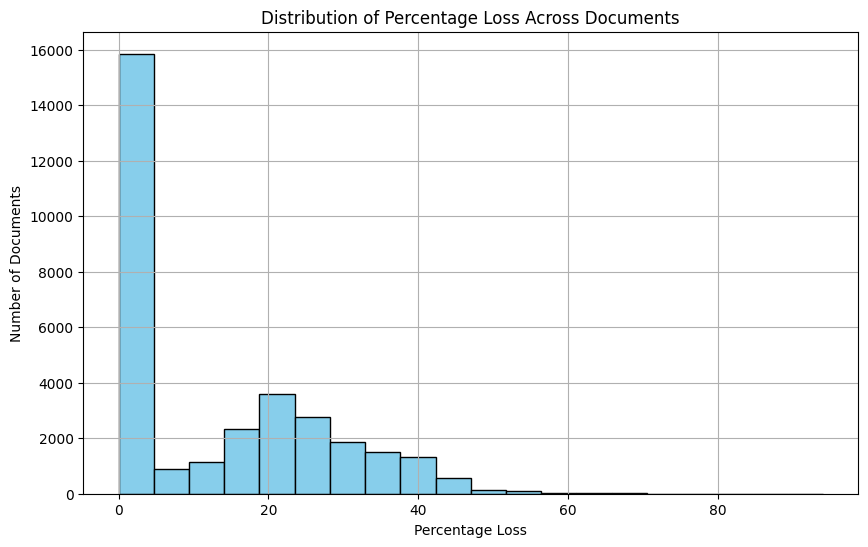

In [53]:
plt.figure(figsize=(10, 6))
plt.hist(percentage_lost_list, bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Percentage Loss Across Documents')
plt.xlabel('Percentage Loss')
plt.ylabel('Number of Documents')
plt.grid(True)
plt.savefig('percentage_loss_distribution_baii.png', dpi=300, bbox_inches='tight')

plt.show()

In [9]:
from sentence_transformers import SentenceTransformer

# final selection of embedding model from MTEB leaderboard 

embedding_model_gte = SentenceTransformer('thenlper/gte-small')


/home3/nkcb64/myjupyterenv/lib/python3.9/site-packages/sentence_transformers/cross_encoder/CrossEncoder.py:11: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm, trange


In [55]:
tokenizer4 = model4.tokenizer

# Check the maximum sequence length
max_seq_length = tokenizer4.model_max_length

print(f"Maximum Sequence Length: {max_seq_length}")


Maximum Sequence Length: 512


In [56]:
num_tokens_list = []
tokens_lost_list = []
percentage_lost_list = []

# Loop through each document in the list
for i, document in enumerate(docs):
    # Tokenize the document
    tokens = tokenizer4.encode(document, truncation=False)

    # Calculate the number of tokens in the document
    num_tokens = len(tokens)
    num_tokens_list.append(num_tokens)

    # Check how many tokens are lost
    if num_tokens > max_seq_length:
        tokens_lost = num_tokens - max_seq_length
        percentage_lost = (tokens_lost / num_tokens) * 100
    else:
        tokens_lost = 0
        percentage_lost = 0.0

    tokens_lost_list.append(tokens_lost)
    percentage_lost_list.append(percentage_lost)


Token indices sequence length is longer than the specified maximum sequence length for this model (826 > 512). Running this sequence through the model will result in indexing errors


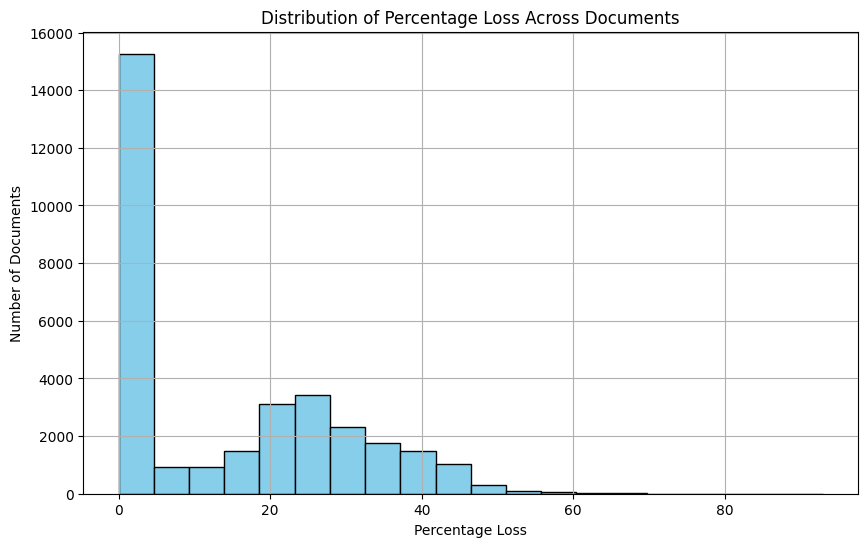

In [57]:
plt.figure(figsize=(10, 6))
plt.hist(percentage_lost_list, bins=20, color='skyblue', edgecolor='black')
plt.title('Distribution of Percentage Loss Across Documents')
plt.xlabel('Percentage Loss')
plt.ylabel('Number of Documents')
plt.grid(True)
plt.savefig('percentage_loss_distribution_baii.png', dpi=300, bbox_inches='tight')

plt.show()

In [12]:
# Pre-calculate embeddings as reccomended by documentation best practice

gte_embeddings = embedding_model_gte.encode(docs, show_progress_bar=True)


Batches:   0%|          | 0/1006 [00:00<?, ?it/s]

In [13]:
import pickle

# Pickle calculated embeddings 

with open('gte_embeddings.pkl', 'wb') as file:
    pickle.dump(gte_embeddings, file)

In [10]:
import pickle

# Load pickled embeddings for faster repeated model training 

with open('gte_embeddings.pkl', 'rb') as file:
    gte_embeddings = pickle.load(file)

In [78]:
from bertopic import BERTopic

# Train model with chosen embeddings but default hyperparameters as baseline 

topic_model_gte = BERTopic(embedding_model=embedding_model_gte)


In [79]:
topics, probs = topic_model_gte.fit_transform(docs, gte_embeddings)


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

In [84]:
topic_model_gte.get_topic_info()

,Topic,Count,Name,Representation,Representative_Docs
0,-1,12108,-1_and_the_of_to,"[and, the, of, to, in, it, for, is, that, on]",[America Online may still be the largest Inter...
1,0,512,0_microsoft_antitrust_jackson_justice,"[microsoft, antitrust, jackson, justice, court...",[A federal judge ordered Microsoft on Thursday...
2,1,381,1_domain_icann_domains_names,"[domain, icann, domains, names, name, dot, sol...",[Network Solutions is making the most of its l...
3,2,326,2_game_games_gaming_players,"[game, games, gaming, players, gamers, play, q...",[LOS ANGELES -- The numbers right now are smal...
4,3,304,3_apple_mac_jobs_os,"[apple, mac, jobs, os, imac, macworld, macinto...",[Apple Computer said Wednesday it will invest ...
...,...,...,...,...,...
521,520,10,520_li_chinese_gao_china,"[li, chinese, gao, china, beijing, spying, qin...",[BEIJING -- An American business professor was...
522,521,10,521_bacterium_flu_influenza_genes,"[bacterium, flu, influenza, genes, strain, res...",[WASHINGTON -- A frozen corpse and preserved s...
523,522,10,522_well_community_klick_hafner,"[well, community, klick, hafner, thau, klixter...","[Whoever said, ""If you build it, they will com..."
524,523,10,523_miss_goddess_kumari_galanter,"[miss, goddess, kumari, galanter, gossuin, msw...",[Beauty meets the bulletproof vest in a gown d...


In [81]:
# Calculate coherence npmi 

from gensim.models import CoherenceModel
from gensim import corpora

vectorizer = topic_model_gte.vectorizer_model
analyzer = vectorizer.build_analyzer()


words = vectorizer.get_feature_names_out()
tokens = [analyzer(doc) for doc in docs]
dictionary = corpora.Dictionary(tokens)
corpus = [dictionary.doc2bow(token) for token in tokens]
topic_words = []
for topic_num in range(len(topic_model_gte.get_topics())):
    topic = topic_model_gte.get_topic(topic_num)
    if topic:  # Ensure the topic is not empty or invalid
        topic_words.append([word for word, _ in topic])

In [82]:
coherence_model = CoherenceModel(topics=topic_words, 
                                 texts=tokens, 
                                 corpus=corpus,
                                 dictionary=dictionary, 
                                 coherence='c_npmi')

# Step 7: Calculate the NPMI coherence score
coherence = coherence_model.get_coherence()

print(f"NPMI Coherence Score: {coherence}")

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

NPMI Coherence Score: 0.11542478604351981


In [83]:
# Visualize hierarchical clustering 

topic_model_gte.visualize_hierarchy()

In [85]:
fig_gte = topic_model_gte.visualize_topics()

In [86]:
# Save interactive plots as html 

fig_gte.write_html("fig_gte_intertopic.html")

In [ ]:
# Hyperparamter tuning with Optuna with the objective of maximizing npmi coherence 


import optuna
from bertopic import BERTopic
from hdbscan import HDBSCAN
import umap
from sklearn.metrics import silhouette_score
from gensim.corpora import Dictionary
from gensim.models.coherencemodel import CoherenceModel
from gensim.utils import simple_preprocess
import numpy as np

def calculate_npmi_score(model, docs):
    # Use the vectorizer from the BERTopic model to tokenize the documents
    vectorizer = model.vectorizer_model
    analyzer = vectorizer.build_analyzer()

    tokens = [analyzer(doc) for doc in docs]
    
    # Create Gensim dictionary and corpus
    dictionary = Dictionary(tokens)
    corpus = [dictionary.doc2bow(token) for token in tokens]

    # Get the topics from BERTopic
    topics = model.get_topics()
    top_n_words = [[word for word, _ in topic] for topic in topics.values()]

    # Compute NPMI using Gensim
    coherence_model = CoherenceModel(
        topics=top_n_words, 
        texts=tokens, 
        dictionary=dictionary, 
        corpus=corpus, 
        coherence='c_npmi'
    )
    return coherence_model.get_coherence()

def objective(trial):
    # Suggest hyperparameters with adjusted ranges for around 100 topics
    n_neighbors = trial.suggest_int('n_neighbors', 15, 100)
    min_dist = trial.suggest_float('min_dist', 0.0, 0.5)
    min_cluster_size = trial.suggest_int('min_cluster_size', 5, 100)
    min_samples = trial.suggest_int('min_samples', 5, 100)

    # Create UMAP and HDBSCAN models with suggested parameters
    umap_model = umap.UMAP(n_neighbors=n_neighbors, min_dist=min_dist, metric='cosine')
    hdbscan_model = HDBSCAN(min_cluster_size=min_cluster_size, min_samples=min_samples)

    # Create BERTopic model with pre-calculated embeddings
    topic_model = BERTopic(umap_model=umap_model, hdbscan_model=hdbscan_model)
    
    # Fit the model using the full dataset
    topics, probs = topic_model.fit_transform(docs, embeddings=gte_embeddings)

    # Calculate NPMI coherence score using the vectorizer method
    npmi_score = calculate_npmi_score(topic_model, docs)
    
    return npmi_score

# Create study and optimize
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)

# Best parameters
print("Best Parameters: ", study.best_params)

[I 2024-08-17 23:22:25,548] A new study created in memory with name: no-name-d4a35d70-1f6e-4120-942f-b97784763ac1
[I 2024-08-17 23:26:49,663] Trial 0 finished with value: -0.01918894488028201 and parameters: {'n_neighbors': 38, 'min_dist': 0.4045780485341841, 'min_cluster_size': 8, 'min_samples': 90}. Best is trial 0 with value: -0.01918894488028201.
[I 2024-08-17 23:33:47,818] Trial 1 finished with value: 0.04649699844357352 and parameters: {'n_neighbors': 85, 'min_dist': 0.020716563183593606, 'min_cluster_size': 76, 'min_samples': 32}. Best is trial 1 with value: 0.04649699844357352.
[I 2024-08-17 23:38:33,670] Trial 2 finished with value: -0.03299666175744923 and parameters: {'n_neighbors': 62, 'min_dist': 0.4551085251103635, 'min_cluster_size': 82, 'min_samples': 99}. Best is trial 1 with value: 0.04649699844357352.
[I 2024-08-17 23:43:41,407] Trial 3 finished with value: -0.02929122063179566 and parameters: {'n_neighbors': 97, 'min_dist': 0.3199151104478637, 'min_cluster_size': 27

[I 2024-08-18 02:54:49,431] Trial 34 finished with value: 0.12151470639926036 and parameters: {'n_neighbors': 57, 'min_dist': 0.0233091128961253, 'min_cluster_size': 29, 'min_samples': 26}. Best is trial 34 with value: 0.12151470639926036.
[I 2024-08-18 03:02:29,448] Trial 35 finished with value: 0.11999291286024552 and parameters: {'n_neighbors': 77, 'min_dist': 0.0011098359279822778, 'min_cluster_size': 26, 'min_samples': 28}. Best is trial 34 with value: 0.12151470639926036.
[I 2024-08-18 03:10:18,421] Trial 36 finished with value: 0.1188800938169273 and parameters: {'n_neighbors': 90, 'min_dist': 0.008615186588732617, 'min_cluster_size': 23, 'min_samples': 28}. Best is trial 34 with value: 0.12151470639926036.
[I 2024-08-18 03:17:50,740] Trial 37 finished with value: 0.11347924417824376 and parameters: {'n_neighbors': 91, 'min_dist': 0.01702112608055987, 'min_cluster_size': 25, 'min_samples': 29}. Best is trial 34 with value: 0.12151470639926036.
[I 2024-08-18 03:22:37,132] Trial 3

In [ ]:
# Save study object dataframe with all the trial information

trials_df = study.trials_dataframe()
sorted_trials_df = trials_df.sort_values(by='value', ascending=False)
sorted_trials_df.to_csv('optuna_trials_sorted2.csv', index=False)


In [12]:
# Train the model with the hyperparameters values of the best trial 

from umap import UMAP

umap_model = UMAP(n_neighbors=57, n_components=5, min_dist=0.023, metric='cosine', random_state=42)

In [13]:
from hdbscan import HDBSCAN

hdbscan_model = HDBSCAN(min_cluster_size=29, min_samples=26, metric='euclidean', cluster_selection_method='eom', prediction_data=True)

In [14]:
from sklearn.feature_extraction.text import CountVectorizer
vectorizer_model = CountVectorizer(stop_words="english", min_df=2, ngram_range=(1, 1))

In [15]:
from bertopic.representation import KeyBERTInspired
keybert_model = KeyBERTInspired()

In [16]:
from bertopic.vectorizers import ClassTfidfTransformer

ctfidf_model = ClassTfidfTransformer(bm25_weighting=True, reduce_frequent_words=True)

In [30]:
from bertopic import BERTopic

topic_model = BERTopic(

  # Pipeline models
  embedding_model=embedding_model_gte,
  umap_model=umap_model,
  hdbscan_model=hdbscan_model,
  ctfidf_model=ctfidf_model,
  representation_model=keybert_model,

  # Hyperparameters
  top_n_words=10,
  verbose=True
)

topics, probs = topic_model.fit_transform(docs, gte_embeddings)

2024-08-18 21:04:42,749 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-08-18 21:05:55,685 - BERTopic - Dimensionality - Completed ✓
2024-08-18 21:05:55,687 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-08-18 21:05:57,570 - BERTopic - Cluster - Completed ✓
2024-08-18 21:05:57,579 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-08-18 21:06:23,329 - BERTopic - Representation - Completed ✓


In [31]:
topic_info = topic_model.get_topic_info()

In [32]:
# Load topic information for optimised model 

topic_info_df_optimisedgte = pd.DataFrame(topic_info)


In [33]:
topic_info_df_optimisedgte

,Topic,Count,Name,Representation,Representative_Docs
0,-1,14003,-1_web_net_cable_network,"[web, net, cable, network, media, news, busine...","[Macromedia, mostly known as the creator of so..."
1,0,1519,0_nasdaq_stocks_stock_investors,"[nasdaq, stocks, stock, investors, traders, do...","[The trading week ended on a slow note, with s..."
2,1,853,1_riaa_napster_mp3s_mp3,"[riaa, napster, mp3s, mp3, musicnet, musicmatc...",[While record-company execs wring their hands ...
3,2,743,2_mars_nasa_martian_spacecraft,"[mars, nasa, martian, spacecraft, planetary, a...",[Frustrated mission controllers failed again S...
4,3,671,3_microsoft_antitrust_windows_doj,"[microsoft, antitrust, windows, doj, redmond, ...",[The key events leading up to Monday's decisio...
...,...,...,...,...,...
130,129,30,129_comics_comicdom_comic_comix,"[comics, comicdom, comic, comix, comiclopedia,...","[Any artistic form, be it a Gregorian chant or..."
131,130,29,130_oracle_ellison_oracle7_computers,"[oracle, ellison, oracle7, computers, oracle8,...",[Larry Ellison is apparently smarting from Mic...
132,131,29,131_telecommunications_merger_telecom_telecomm...,"[telecommunications, merger, telecom, telecomm...",[With its surprise acquisition of US cable-TV ...
133,132,29,132_translation_translating_translators_transl...,"[translation, translating, translators, transl...",[Universal Translators- A look at the hubs for...


In [36]:
topic_info_df_optimisedgte.to_csv('topic_info_optimisedgte.csv', index=False)


In [34]:
# Create intertopic chart for optimized model 

gte_optimised_vis = topic_model.visualize_topics()

In [38]:
gte_optimised_vis

In [39]:
gte_optimised_vis.write_html("intertopic_gte_optimised.html")

In [35]:
# Reduce outliers with c-tfidf method and 0.1 as probability threshold 

new_topics = topic_model.reduce_outliers(docs, topics , strategy="c-tf-idf", threshold=0.1)


In [36]:
# Update model with reduced outliers topics 

topic_model.update_topics(docs, topics=new_topics)


2024-08-18 21:07:04,737 - BERTopic - WARNING: Using a custom list of topic assignments may lead to errors if topic reduction techniques are used afterwards. Make sure that manually assigning topics is the last step in the pipeline.Note that topic embeddings will also be created through weightedc-TF-IDF embeddings instead of centroid embeddings.


In [37]:
reducedoutlier_gte = topic_model.get_topic_info()

In [38]:
topic_info_df_reduced_gte = pd.DataFrame(reducedoutlier_gte)


In [47]:
topic_info_df_reduced_gte.to_csv('topic_info_reducedgte.csv', index=False)


In [39]:
topic_info_df_reduced_gte

,Topic,Count,Name,Representation,Representative_Docs
0,-1,2085,-1_br_his_the_in,"[br, his, the, in, com, of, and, was, for, to]","[Macromedia, mostly known as the creator of so..."
1,0,1570,0_16_percent_stocks_dow,"[16, percent, stocks, dow, index, nasdaq, poin...","[The trading week ended on a slow note, with s..."
2,1,1162,1_music_mp3_napster_recording,"[music, mp3, napster, recording, labels, digit...",[While record-company execs wring their hands ...
3,2,870,2_space_nasa_satellite_earth,"[space, nasa, satellite, earth, iridium, mars,...",[Frustrated mission controllers failed again S...
4,3,913,3_microsoft_antitrust_court_justice,"[microsoft, antitrust, court, justice, case, j...",[The key events leading up to Monday's decisio...
...,...,...,...,...,...
130,129,75,129_comics_comic_book_marvel,"[comics, comic, book, marvel, mccloud, art, yo...","[Any artistic form, be it a Gregorian chant or..."
131,130,54,130_oracle_ellison_database_software,"[oracle, ellison, database, software, nci, syb...",[Larry Ellison is apparently smarting from Mic...
132,131,177,131_cable_tci_at_mediaone,"[cable, tci, at, mediaone, comcast, deal, bill...",[With its surprise acquisition of US cable-TV ...
133,132,47,132_language_translation_english_languages,"[language, translation, english, languages, kl...",[Universal Translators- A look at the hubs for...


# Section Two: Visualizing Optimized Model Results 

In [49]:
topic_model.visualize_topics()

In [50]:
from gensim.models import CoherenceModel
from gensim import corpora

vectorizer = topic_model.vectorizer_model
analyzer = vectorizer.build_analyzer()


words = vectorizer.get_feature_names_out()
tokens = [analyzer(doc) for doc in docs]
dictionary = corpora.Dictionary(tokens)
corpus = [dictionary.doc2bow(token) for token in tokens]
topic_words = []
for topic_num in range(len(topic_model.get_topics())):
    topic = topic_model.get_topic(topic_num)
    if topic:  # Ensure the topic is not empty or invalid
        topic_words.append([word for word, _ in topic])

In [51]:
# Re-calculate coherence score after outlier reduction 

coherence_model = CoherenceModel(topics=topic_words, 
                                 texts=tokens, 
                                 corpus=corpus,
                                 dictionary=dictionary, 
                                 coherence='c_npmi')

# Step 7: Calculate the NPMI coherence score
coherence = coherence_model.get_coherence()

print(f"NPMI Coherence Score: {coherence}")

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)
huggingface/tokenizers: The 

NPMI Coherence Score: 0.13324472525152714


In [52]:
# Calculate topic diversity 

top_n_words = 10  # You can adjust this number based on your needs
topic_words = []
for topic_num in range(len(topic_model.get_topics())):
    topic = topic_model.get_topic(topic_num)
    if topic:  # Ensure the topic is not empty or invalid
        words = [word for word, _ in topic[:top_n_words]]
        topic_words.extend(words)  # Collect all top words across all topics

In [53]:
unique_words = set(topic_words)
unique_word_count = len(unique_words)
total_words = len(topic_words)

In [54]:
topic_diversity = unique_word_count / total_words
print(f"Topic Diversity: {topic_diversity:.4f}")

Topic Diversity: 0.6619


In [55]:
# Visualize hierachical clustering for optimized model 

topic_model.visualize_hierarchy()

In [57]:
!python -m spacy download en_core_web_sm


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


     |████████████████████████████████| 12.8 MB 3.7 MB/s eta 0:00:01          | 8.5 MB 3.7 MB/s eta 0:00:02
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [17]:
# Run multi-aspect topic modelling for the different representations 

from bertopic.representation import PartOfSpeech
from bertopic.representation import MaximalMarginalRelevance

aspect_model1 = PartOfSpeech("en_core_web_sm")
aspect_model2 = [KeyBERTInspired(top_n_words=30), MaximalMarginalRelevance(diversity=.5)]

In [18]:
representation_model = {
   "Keybert": keybert_model,
   "POS":  aspect_model1,
   "MMR":  aspect_model2 
}

In [19]:
from bertopic import BERTopic

multi_topic_model = BERTopic(

  # Pipeline models
  embedding_model=embedding_model_gte,
  umap_model=umap_model,
  hdbscan_model=hdbscan_model,
  ctfidf_model=ctfidf_model,
  representation_model=representation_model,

  # Hyperparameters
  top_n_words=10,
  verbose=True
)

topics, probs = multi_topic_model.fit_transform(docs, gte_embeddings)

2024-08-28 17:15:29,201 - BERTopic - Dimensionality - Fitting the dimensionality reduction algorithm
2024-08-28 17:16:58,697 - BERTopic - Dimensionality - Completed ✓
2024-08-28 17:16:58,700 - BERTopic - Cluster - Start clustering the reduced embeddings
2024-08-28 17:17:03,327 - BERTopic - Cluster - Completed ✓
2024-08-28 17:17:03,354 - BERTopic - Representation - Extracting topics from clusters using representation models.
2024-08-28 17:19:42,108 - BERTopic - Representation - Completed ✓


In [20]:
new_topics2 = multi_topic_model.reduce_outliers(docs, topics , strategy="c-tf-idf", threshold=0.1)


In [21]:
multi_topic_model.update_topics(docs, topics=new_topics2)


2024-08-28 17:20:15,870 - BERTopic - WARNING: Using a custom list of topic assignments may lead to errors if topic reduction techniques are used afterwards. Make sure that manually assigning topics is the last step in the pipeline.Note that topic embeddings will also be created through weightedc-TF-IDF embeddings instead of centroid embeddings.


In [21]:
multi_topic_model.get_topic_info()

,Topic,Count,Name,Representation,Keybert,POS,MMR,Representative_Docs
0,-1,2085,-1_br_his_the_in,"[br, his, the, in, com, of, and, was, for, to]","[web, net, cable, network, media, news, busine...","[cable, site, media, world, old, information, ...","[net, cable, media, business, customers, onlin...","[Macromedia, mostly known as the creator of so..."
1,0,1570,0_16_percent_stocks_dow,"[16, percent, stocks, dow, index, nasdaq, poin...","[nasdaq, stocks, stock, investors, traders, do...","[index, stocks, points, composite, industrial,...","[nasdaq, traders, dow, ftse, analysts, dropped...","[The trading week ended on a slow note, with s..."
2,1,1162,1_music_mp3_napster_recording,"[music, mp3, napster, recording, labels, digit...","[riaa, napster, mp3s, mp3, musicnet, musicmatc...","[music, labels, recording, songs, files, artis...","[riaa, napster, mp3s, musicnet, copyrighted, p...",[While record-company execs wring their hands ...
3,2,870,2_space_nasa_satellite_earth,"[space, nasa, satellite, earth, iridium, mars,...","[mars, nasa, martian, spacecraft, planetary, a...","[space, iridium, satellite, earth, orbit, sate...","[mars, nasa, spacecraft, satellites, cosmonaut...",[Frustrated mission controllers failed again S...
4,3,913,3_microsoft_antitrust_court_justice,"[microsoft, antitrust, court, justice, case, j...","[microsoft, antitrust, windows, doj, redmond, ...","[antitrust, judge, windows, court, gates, depa...","[microsoft, antitrust, doj, lawsuit, illegally...",[The key events leading up to Monday's decisio...
...,...,...,...,...,...,...,...,...
130,129,75,129_comics_comic_book_marvel,"[comics, comic, book, marvel, mccloud, art, yo...","[comics, comicdom, comic, comix, comiclopedia,...","[comics, comic, comix, cartoonists, crumb, str...","[comics, comix, www, readership, anime, fantag...","[Any artistic form, be it a Gregorian chant or..."
131,130,54,130_oracle_ellison_database_software,"[oracle, ellison, database, software, nci, syb...","[oracle, ellison, oracle7, computers, oracle8,...","[database, 9i, servers, server, applications, ...","[oracle, servers, netcom, nctv, solution, comp...",[Larry Ellison is apparently smarting from Mic...
132,131,177,131_cable_tci_at_mediaone,"[cable, tci, at, mediaone, comcast, deal, bill...","[telecommunications, merger, telecom, telecomm...","[cable, wireless, distance, local, merger, sto...","[telecommunications, merger, comcast, teleglob...",[With its surprise acquisition of US cable-TV ...
133,132,47,132_language_translation_english_languages,"[language, translation, english, languages, kl...","[translation, translating, translators, transl...","[translation, language, languages, translators...","[translating, multilingual, linguists, esperan...",[Universal Translators- A look at the hubs for...


In [31]:

# Create hierarchical clustering plot with linkages 

from scipy.cluster import hierarchy as sch

linkage_function = lambda x: sch.linkage(x, 'complete', optimal_ordering=True)
hierarchical_topics = multi_topic_model.hierarchical_topics(docs, linkage_function=linkage_function)

100%|██████████| 133/133 [00:01<00:00, 111.51it/s]


In [32]:
multi_vis = multi_topic_model.visualize_hierarchy(hierarchical_topics=hierarchical_topics)


In [33]:
multi_vis.write_html("multi_hierarchy_complete.html")

In [88]:
# Reduce embeddings to 2D for clustering visualization 

reduced_embeddings = UMAP(n_neighbors=10, n_components=2, 
                          min_dist=0.0, metric='cosine').fit_transform(gte_embeddings)

In [90]:
multi_topic_model.visualize_documents(docs, reduced_embeddings=reduced_embeddings, 
                                hide_document_hover=True, hide_annotations=True)

In [45]:
multi = multi_topic_model.get_topic_info()

multi_df = pd.DataFrame(multi)

multi_df.to_csv('topic_info_multi_gte.csv', index=False)


In [22]:
!pip install bertopic transformers


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


# Section Three: Experimentation with NLP techniques for results interpretation


In [47]:
from transformers import pipeline
from bertopic.representation import TextGeneration

# Initialize the text generation pipeline for summary label generation and enable gpu acceleration 

generator = pipeline('text2text-generation', model='google/flan-t5-base', device=0)



In [121]:
def generate_topic_label(topic_model, topic_id, generator):
    """
    Generate a descriptive two-word label for a given topic using its keywords.

    :param topic_model: Trained BERTopic model
    :param topic_id: The ID of the topic to label
    :param generator: Initialized text generation pipeline
    :return: Generated two-word descriptive label as a string
    """
    # Retrieve keywords for the specified topic
    topic_keywords = topic_model.get_topic(topic_id)
    
    # Format the keywords as a single string
    keywords = ", ".join([word for word, _ in topic_keywords])
    
    # Create the prompt
    prompt_template = (
    "I have a topic described by the following keywords: [KEYWORDS]. "
    "Based on these keywords, provide a two-word descriptive label that best summarizes the topic. "
    "For example, if the keywords were 'AI, machine learning, deep learning', a good label might be 'AI Techniques'."
    )    
    prompt = prompt_template.replace("[KEYWORDS]", keywords)
    
    # Generate the label
    generated_label = generator(prompt, max_length=20, num_return_sequences=1, top_k=50, temperature=0.7)[0]['generated_text']
    
    # Clean up the label and ensure it is two words
    cleaned_label = ' '.join(generated_label.strip().split()[:2])
    
    # Further clean-up: remove common generic starts like "What is", "How to", etc.
    if cleaned_label.lower().startswith(('what', 'how', 'why')):
        cleaned_label = cleaned_label.split(' ', 1)[-1].strip()

    return cleaned_label


In [122]:
def generate_labels_for_all_topics(topic_model, generator):
    # Get all topic IDs from the BERTopic model
    topic_ids = topic_model.get_topic_info()['Topic'].tolist()
    
    # Dictionary to store topic labels
    topic_labels = {}
    
    for topic_id in topic_ids:
        # Skip the -1 topic, which typically represents outliers or unclassified documents
        if topic_id == -1:
            continue
        
        # Generate a label for each topic
        label = generate_topic_label(topic_model, topic_id, generator)
        topic_labels[topic_id] = label
        print(f"Generated label for topic {topic_id}: {label}")
    
    return topic_labels

topic_labels = generate_labels_for_all_topics(multi_topic_model, generator)

Generated label for topic 0: NASDAQ Composite
Generated label for topic 1: music
Generated label for topic 2: nasa spacecraft
Generated label for topic 3: Microsoft
Generated label for topic 4: game
Generated label for topic 5: Domains
Generated label for topic 6: fbi
Generated label for topic 7: baseball player
Generated label for topic 8: tv
Generated label for topic 9: Apple Inc.
Generated label for topic 10: y2k
Generated label for topic 11: html
Generated label for topic 12: Lucent
Generated label for topic 13: pornography
Generated label for topic 14: AI
Generated label for topic 15: election, gore,
Generated label for topic 16: AI in
Generated label for topic 17: com
Generated label for topic 18: White House
Generated label for topic 19: article
Generated label for topic 20: who was
Generated label for topic 21: Artificial intelligence
Generated label for topic 22: AOL is
Generated label for topic 23: nasdaq stock
Generated label for topic 24: art
Generated label for topic 25: I

In [123]:
# Add the generated labels as the final column in the dataframe with the multi-representation topics 

topic_info_all_gte = multi_topic_model.get_topic_info()

# Add the generated labels to the DataFrame
topic_info_all_gte['Generated_Label'] = topic_info_all_gte['Topic'].map(topic_labels)

# Display the DataFrame with the new column
print(topic_info_all_gte)

topic_info_all_gte.to_csv('gtemodel_all_multi.csv', index=False)

print("DataFrame saved to 'final_model_all_multi.csv'")

     Topic  Count                                        Name  \
0       -1   2085                            -1_br_his_the_in   
1        0   1570                     0_16_percent_stocks_dow   
2        1   1162               1_music_mp3_napster_recording   
3        2    870                2_space_nasa_satellite_earth   
4        3    913         3_microsoft_antitrust_court_justice   
..     ...    ...                                         ...   
130    129     75                129_comics_comic_book_marvel   
131    130     54        130_oracle_ellison_database_software   
132    131    177                   131_cable_tci_at_mediaone   
133    132     47  132_language_translation_english_languages   
134    133     36                 133_burning_man_desert_rock   

                                        Representation  \
0       [br, his, the, in, com, of, and, was, for, to]   
1    [16, percent, stocks, dow, index, nasdaq, poin...   
2    [music, mp3, napster, recording, labels,

In [124]:
topic_0_info = topic_info_all_gte[topic_info_all_gte['Topic'] == 0]

# Extract the representations or relevant columns (adjust this based on what you need)
# For example, if you want to extract all representations:
topic_0_representations = topic_0_info[['Topic', 'Representation', 'Keybert', 'POS', 'MMR', 'Generated_Label']]  # Adjust columns as needed

# Save the extracted information to a CSV file
topic_0_representations.to_csv('topic_0_representations.csv', index=False)

#print("Topic 3 representations saved to 'topic_3_representations.csv'")

In [89]:
!pip install tabulate

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [125]:
from IPython.display import display, HTML
display(HTML(topic_0_representations.to_html(index=False)))



Topic,Representation,Keybert,POS,MMR,Generated_Label
0,"[16, percent, stocks, dow, index, nasdaq, points, rose, was, fell]","[nasdaq, stocks, stock, investors, traders, dow, trading, tech, ftse, earnings]","[index, stocks, points, composite, industrial, earnings, inflation, investors, percent, average]","[nasdaq, traders, dow, ftse, analysts, dropped, dell, gains, economic, greenspan]",NASDAQ Composite


In [96]:
# Create zero shot classification pipeline with transformer model for labelling candidate labels to topics 

zero_shot_classifier = pipeline("zero-shot-classification", model="valhalla/distilbart-mnli-12-1", device=0)


In [126]:
candidate_labels = ["gloabl network", "gadgets", "virtual community", "freedom", "regulation", "cyberspace", "privacy", "international affairs", "silicon valley", "entrepreneur", "success",  
                   'innovation', 'new', 'revolution', 'progress','equal', 'communication', 'collaboration', 'risk', 'control', 'governemnt', 'hierarchy', 'protection', 'threat', 'danger']


In [127]:
topics_keywords = multi_topic_model.get_topics()


In [138]:
# Classify each topic to a candidate label with highest probability with a minimum threshold of 0.2 

def generate_zero_shot_labels(topics_keywords, classifier, candidate_labels, threshold=0.2):
    topic_labels = {}
    for topic_id, keywords in topics_keywords.items():
        if topic_id == -1:  # Skip outlier topic
            continue
        # Concatenate the keywords into a single string
        keywords_str = ", ".join([word for word, _ in keywords])
        # Use the zero-shot classifier to predict the label
        result = classifier(keywords_str, candidate_labels)
        # Select the label only if its score exceeds the threshold
        if result['scores'][0] >= threshold:
            topic_labels[topic_id] = result['labels'][0]
        else:
            topic_labels[topic_id] = "Uncertain"  # Or any default label if the threshold isn't met
    return topic_labels

In [139]:
topic_labels = generate_zero_shot_labels(topics_keywords, zero_shot_classifier, candidate_labels, threshold=0.2)


In [140]:
topic_info_all_gte['Zero_Shot_Label'] = topic_info_all_gte['Topic'].map(topic_labels)

# Display the DataFrame with the new column
print(topic_info_all_gte)

     Topic  Count                                        Name  \
0       -1   2085                            -1_br_his_the_in   
1        0   1570                     0_16_percent_stocks_dow   
2        1   1162               1_music_mp3_napster_recording   
3        2    870                2_space_nasa_satellite_earth   
4        3    913         3_microsoft_antitrust_court_justice   
..     ...    ...                                         ...   
130    129     75                129_comics_comic_book_marvel   
131    130     54        130_oracle_ellison_database_software   
132    131    177                   131_cable_tci_at_mediaone   
133    132     47  132_language_translation_english_languages   
134    133     36                 133_burning_man_desert_rock   

                                        Representation  \
0       [br, his, the, in, com, of, and, was, for, to]   
1    [16, percent, stocks, dow, index, nasdaq, poin...   
2    [music, mp3, napster, recording, labels,

In [141]:
topic_info_all_gte.to_csv('topic_labels_with_zero_shot_new.csv', index=False)


In [48]:
import pandas as pd
topic_info_all_gtedf = pd.read_csv('topic_labels_with_zero_shot_new.csv')

In [53]:
selected_columns = ['Topic', 'Keybert', 'Generated_Label', 'Zero_Shot_Label']

# Extract rows from index 0 to 8 (inclusive) and select only the specified columns
subset_df = topic_info_all_gtedf.loc[1:10, selected_columns]

# Save the subset to a CSV file

subset_df['Keybert'] = subset_df['Keybert'].apply(lambda x: ' '.join(x.split()[:5]))

subset_df.to_csv('subset_topic_info_selected_columns.csv', index=False)

# Confirm the operation by printing the extracted subset
print(subset_df)

    Topic                                            Keybert  \
1       0  ['nasdaq', 'stocks', 'stock', 'investors', 'tr...   
2       1     ['riaa', 'napster', 'mp3s', 'mp3', 'musicnet',   
3       2  ['mars', 'nasa', 'martian', 'spacecraft', 'pla...   
4       3  ['microsoft', 'antitrust', 'windows', 'doj', '...   
5       4  ['videogames', 'consoles', 'gaming', 'videogam...   
6       5       ['domains', 'icann', 'domain', 'dns', 'net',   
7       6  ['fbi', 'wiretap', 'wiretaps', 'terrorism', 'w...   
8       7  ['postseason', 'dodgers', 'baseball', 'homers'...   
9       8  ['directv', 'televisions', 'hdtv', 'television...   
10      9  ['macworld', 'apple', 'macintosh', 'imacs', 'm...   

     Generated_Label Zero_Shot_Label  
1   NASDAQ Composite       Uncertain  
2              music       Uncertain  
3    nasa spacecraft       Uncertain  
4          Microsoft      governemnt  
5               game       Uncertain  
6            Domains      protection  
7                fbi  

In [43]:
keyword_list = ["global network", "gadgets", "virtual community", "freedom", "regulation", "cyberspace", "privacy", "international affairs", "silicon valley", "entrepreneur", "success",  
                   'innovation', 'new', 'revolution', 'progress','equal', 'communication', 'collaboration', 'risk', 'control', 'governemnt', 'hierarchy', 'protection', 'threat', 'danger']


In [100]:
>>> similar_topics, similarity = multi_topic_model.find_topics("control", top_n=5)
>>> multi_topic_model.get_topic(similar_topics[2])

[('fbi', 0.010598404555173632),
 ('security', 0.010149596265300615),
 ('hackers', 0.0075180360508140046),
 ('computer', 0.007435517335448951),
 ('the', 0.007395824390535723),
 ('said', 0.007006762366651889),
 ('to', 0.006914044188464733),
 ('that', 0.006849779849508679),
 ('of', 0.006836117354178176),
 ('he', 0.006763563669573338)]

In [60]:
topic_id = similar_topics[0]
topic_similarity_score = similarity[0]

In [61]:
similar_topics

[69, 103, 86, 31, 12]

In [62]:
similarity

[0.894984943047392,
 0.8931577623327073,
 0.887587883753884,
 0.886792949010125,
 0.8856042464425092]

In [31]:
topic_id

105

In [32]:
!pip install networkx

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [30]:
import matplotlib.pyplot as plt
import os


In [31]:
import networkx as nx

# Create node grpahs for keywords connected with the top 3 similar topics 


def create_and_save_keyword_topic_subgraphs(keyword_list, topic_model, output_dir, top_n=3):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)
    
    for keyword in keyword_list:
        # Create a directed graph for each keyword
        G = nx.DiGraph()
        
        # Add the keyword node
        keyword_node = f"Keyword: {keyword}"
        G.add_node(keyword_node)
        
        # Find the top_n topics for the keyword
        similar_topics, similarity = topic_model.find_topics(keyword, top_n=top_n)
        
        # Add nodes and edges for the topics
        for i, topic_id in enumerate(similar_topics):
            topic_node = f"Topic {topic_id}"
            similarity_score = similarity[i]
            
            # Add topic node with its similarity score
            G.add_node(topic_node)
            
            # Create an edge from the keyword to the topic with the similarity score as a label
            G.add_edge(keyword_node, topic_node, weight=similarity_score)
        
        # Draw the graph
        pos = nx.spring_layout(G)
        edge_labels = nx.get_edge_attributes(G, 'weight')
        
        # Draw nodes and edges with labels
        nx.draw(G, pos, with_labels=True, node_color='lightblue', edge_color='gray', 
                node_size=3000, font_size=12, font_weight='bold', arrows=True)  # Increase font size for labels
        nx.draw_networkx_edge_labels(G, pos, edge_labels={k: f"{v:.2f}" for k, v in edge_labels.items()}, 
                                     font_color='red', font_size=14)  # Increase font size for edge labels
        
        plt.title(f"Keyword-Topic Similarity Graph for '{keyword}'", fontsize=16)  # Increase font size for title
        
        # Save the figure
        plt.savefig(os.path.join(output_dir, f"{keyword}_topic_graph.png"))
        plt.close()


In [32]:
output_dir = "keyword_topic_graphs_new"  # Directory to save the graphs
create_and_save_keyword_topic_subgraphs(newlist, multi_topic_model, output_dir)

In [25]:
def save_topic_representations_for_keywords(keyword_list, topic_model, top_n_topics=3, output_csv='topic_representations.csv'):
    data = {'Keyword': [], 'Topic ID': [], 'Topic Representation': []}
    
    for keyword in keyword_list:
        # Find the top_n_topics for the keyword
        similar_topics, similarity_scores = topic_model.find_topics(keyword, top_n=top_n_topics)
        
        for i, topic_id in enumerate(similar_topics):
            # Get the topic representation (top keywords for the topic)
            topic_representation = topic_model.get_topic(topic_id)
            # Convert the topic representation to a string format
            topic_representation_str = ', '.join([word for word, _ in topic_representation])
            
            # Add the keyword, topic ID, and topic representation to the DataFrame
            data['Keyword'].append(keyword)
            data['Topic ID'].append(topic_id)
            data['Topic Representation'].append(topic_representation_str)
    
    # Create a DataFrame from the data
    result_df = pd.DataFrame(data)
    
    # Save the DataFrame to a CSV file
    result_df.to_csv(output_csv, index=False)

In [26]:
 # Replace with your keyword list
output_csv = "topic_representations.csv"  # Output CSV file path
save_topic_representations_for_keywords(newlist, multi_topic_model, top_n_topics=3, output_csv=output_csv)

In [69]:
def get_representative_docs_and_titles_for_topics(topic_ids, topic_model, df, top_n=3):
    """
    Retrieve representative documents and their titles for a list of selected topics.

    Parameters:
    - topic_ids: A list of topic IDs for which to retrieve documents.
    - topic_model: The BERTopic model used for topic modeling.
    - df: DataFrame containing the titles and content of the documents.
    - top_n: The number of representative documents to retrieve for each topic.

    Returns:
    - A DataFrame with the topic IDs, titles, and content of the representative documents.
    """
    # List to hold the output data
    output_data = []

    for topic_id in topic_ids:
        # Get the representative documents for the given topic
        representative_docs = topic_model.get_representative_docs(topic_id)[:top_n]
        
        for doc in representative_docs:
            # Find the corresponding title for each representative document
            title = df.loc[df['text_content'] == doc, 'title'].values[0]
            # Append the topic ID, title, and document text to the output data
            output_data.append({
                'topic_id': topic_id,
                'title': title,
                'document_text': doc
            })

    # Return the output data as a DataFrame
    return pd.DataFrame(output_data)


In [71]:
output_df = get_representative_docs_and_titles_for_topics(china, multi_topic_model, df, top_n=3)

output_df.to_csv(f"representative_docs_for_topic_{china}.csv", index=False)


In [72]:
output_df.head()

,topic_id,title,document_text
0,121,China: U.S. Better Watch Its Step,BEIJING -- China said Thursday President Bush ...
1,121,Clinton: 'Let's Get China Right',"HONG KONG -- Former President Clinton, in stri..."
2,121,China Verbally Attacks U.S.,BEIJING -- China accused the United States on ...
3,66,Follow the Money,Follow the MoneyThe China IndexHalf of the wor...
4,66,China Unicom's Promising IPO,HONG KONG -- China Unicom's successful $4.9 bi...


In [62]:
from collections import Counter

# Assuming `topic_model` is your BERTopic model and `docs` is your list of documents
topic_assignments = multi_topic_model.topics_  # Get the topic assignment for each document

# List of topic IDs you want to analyze

# Count the number of documents assigned to each topic
topic_counts = Counter(topic_assignments)

# Get the number of documents for each selected topic
selected_topic_counts = {topic: topic_counts.get(topic, 0) for topic in china}

# Calculate the total number of documents assigned to the selected topics
total_documents = sum(selected_topic_counts.values())

# Print results
print("Document counts per selected topic:")
for topic, count in selected_topic_counts.items():
    print(f"Topic {topic}: {count} documents")

print(f"\nTotal number of documents in selected topics: {total_documents}")

Document counts per selected topic:
Topic 121: 70 documents
Topic 66: 107 documents
Topic 110: 77 documents

Total number of documents in selected topics: 254


In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

# Create a graph
G = nx.Graph()

# Add edges based on co-occurrence of keywords and entities
for idx, row in df.iterrows():
    keywords = row['technoutopian_keywords']
    entities = [ent[0] for ent in row['entities']]
    for keyword in keywords:
        for entity in entities:
            G.add_edge(keyword, entity)

# Draw the graph
plt.figure(figsize=(10, 8))
nx.draw_networkx(G, with_labels=True)
plt.show()

In [39]:
print(output_df['document_text'])

0    An influential bipartisan Senate trio has intr...
1    Don't count on Congress for crypto reform.In S...
2    In September 1997, Net users came within a hai...
Name: document_text, dtype: object


In [52]:
!pip install numpy matplotlib scikit-learn pandas datashader scikit-image numba requests jinja2


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [70]:
topic_representations = multi_topic_model.get_topic_info()

topic_ids = topic_representations['Topic'].values
topic_names = topic_representations['Name'].values

In [71]:
topic_representations

,Topic,Count,Name,Representation,Keybert,POS,MMR,Representative_Docs
0,-1,2085,-1_br_his_the_in,"[br, his, the, in, com, of, and, was, for, to]","[web, net, cable, network, media, news, busine...","[cable, site, media, world, old, information, ...","[net, cable, media, business, customers, onlin...","[Macromedia, mostly known as the creator of so..."
1,0,1570,0_16_percent_stocks_dow,"[16, percent, stocks, dow, index, nasdaq, poin...","[nasdaq, stocks, stock, investors, traders, do...","[index, stocks, points, composite, industrial,...","[nasdaq, traders, dow, ftse, analysts, dropped...","[The trading week ended on a slow note, with s..."
2,1,1162,1_music_mp3_napster_recording,"[music, mp3, napster, recording, labels, digit...","[riaa, napster, mp3s, mp3, musicnet, musicmatc...","[music, labels, recording, songs, files, artis...","[riaa, napster, mp3s, musicnet, copyrighted, p...",[While record-company execs wring their hands ...
3,2,870,2_space_nasa_satellite_earth,"[space, nasa, satellite, earth, iridium, mars,...","[mars, nasa, martian, spacecraft, planetary, a...","[space, iridium, satellite, earth, orbit, sate...","[mars, nasa, spacecraft, satellites, cosmonaut...",[Frustrated mission controllers failed again S...
4,3,913,3_microsoft_antitrust_court_justice,"[microsoft, antitrust, court, justice, case, j...","[microsoft, antitrust, windows, doj, redmond, ...","[antitrust, judge, windows, court, gates, depa...","[microsoft, antitrust, doj, lawsuit, illegally...",[The key events leading up to Monday's decisio...
...,...,...,...,...,...,...,...,...
130,129,75,129_comics_comic_book_marvel,"[comics, comic, book, marvel, mccloud, art, yo...","[comics, comicdom, comic, comix, comiclopedia,...","[comics, comic, comix, cartoonists, crumb, str...","[comics, comix, www, readership, anime, fantag...","[Any artistic form, be it a Gregorian chant or..."
131,130,54,130_oracle_ellison_database_software,"[oracle, ellison, database, software, nci, syb...","[oracle, ellison, oracle7, computers, oracle8,...","[database, 9i, servers, server, applications, ...","[oracle, servers, netcom, nctv, solution, comp...",[Larry Ellison is apparently smarting from Mic...
132,131,177,131_cable_tci_at_mediaone,"[cable, tci, at, mediaone, comcast, deal, bill...","[telecommunications, merger, telecom, telecomm...","[cable, wireless, distance, local, merger, sto...","[telecommunications, merger, comcast, teleglob...",[With its surprise acquisition of US cable-TV ...
133,132,47,132_language_translation_english_languages,"[language, translation, english, languages, kl...","[translation, translating, translators, transl...","[translation, language, languages, translators...","[translating, multilingual, linguists, esperan...",[Universal Translators- A look at the hubs for...


In [72]:
labels = [f"Topic {topic_id}: {topic_repr}" for topic_id, topic_repr in zip(topic_ids, topic_names)]

In [74]:
topic_per_doc = multi_topic_model.get_document_info(docs)["Topic"].values
named_topic_per_doc = [labels[topic_id] for topic_id in topic_per_doc]

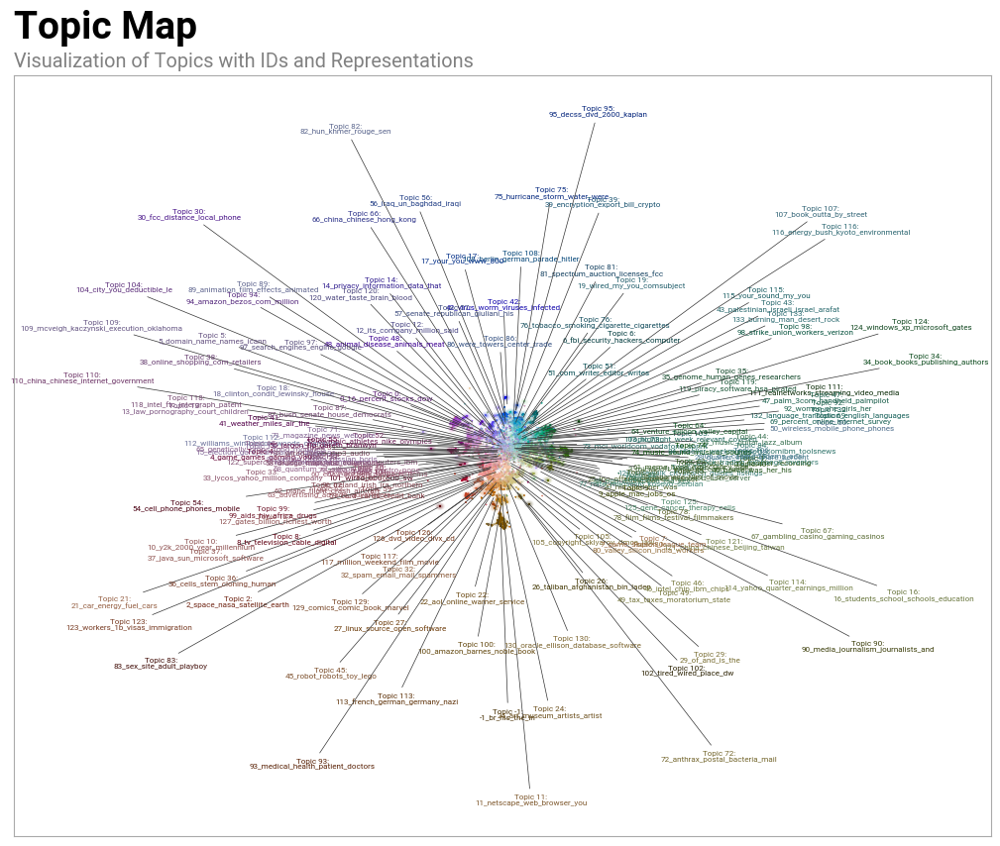

In [76]:
figure, axes = datamapplot.create_plot(
    reduced_embeddings,
    named_topic_per_doc,
    figsize=(10, 8),
    title="Topic Map",
    sub_title="Visualization of Topics with IDs and Representations"
)

# Show the plot
plt.show()

In [23]:
# Final topic lists for defined theme categories


china =[121,66,110]
culture = [51, 129, 24, 107, 29, 19, 83, 71, 90, 34, 53]
Silicon_valley = [92,80, 64]
Online_activity = [11, 61, 11, 8, 4, 103, 1, 9, 97, 63, 38, 33, 22, 69]
cybersecurity = [32, 5, 16, 15, 14, 6, 13, 10, 53, 42, 88, 39, 119, 105, 95]
techcompanies = [127, 130, 37, 3, 124, 27, 46, 118]
stock = [100, 94, 23, 25, 114, 28, 12, 0, 101]

In [97]:
document_info = multi_topic_model.get_document_info(docs)


In [187]:
multi_topic_model.visualize_barchart(topics=[121, 66, 110])


In [189]:
available_topic_ids = list(topic_aspects.keys())
print("Available topic IDs:", available_topic_ids)

Available topic IDs: ['Keybert', 'POS', 'MMR']


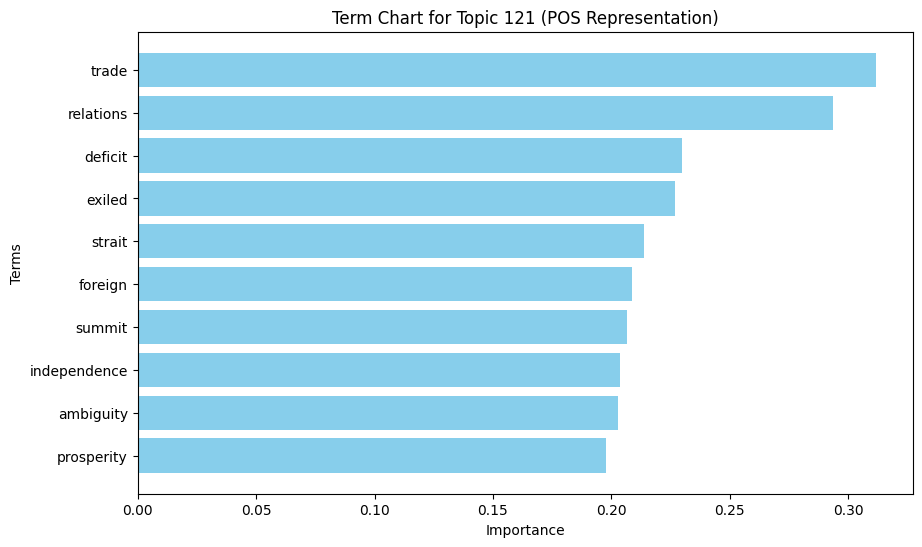

In [191]:
import matplotlib.pyplot as plt

# Select the representation type and topic ID
representation_type = 'POS'  # or 'POS', 'MMR'
topic_id =   # Replace with your topic ID

# Extract the representation terms and scores
try:
    representation = topic_aspects[representation_type][topic_id]
    
    # Assuming representation is a list of tuples (term, score)
    terms, scores = zip(*representation)  # Unzip terms and scores

    # Manually plot the term bar chart
    plt.figure(figsize=(10, 6))
    plt.barh(terms[::-1], scores[::-1], color='skyblue')  # Reverse to plot highest score at the top
    plt.xlabel('Importance')
    plt.ylabel('Terms')
    plt.title(f'Term Chart for Topic {topic_id} ({representation_type} Representation)')
    plt.show()

except KeyError:
    print(f"Topic {topic_id} not found in the '{representation_type}' representation.")

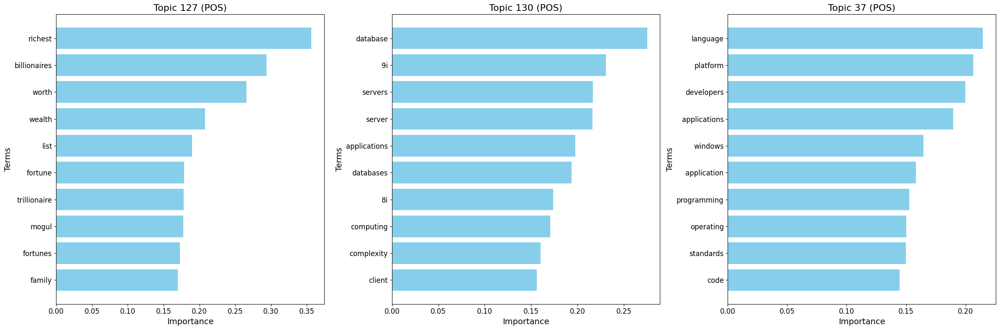

In [33]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(24, 8))  # Increased figure size
topic_aspects = multi_topic_model.topic_aspects_

representation_type = 'POS'
# Font settings
font_size_title = 16
font_size_labels = 14
font_size_ticks = 12

# Loop over each topic and create a subplot
for ax, topic_id in zip(axes, techcompanies):
    try:
        representation = topic_aspects[representation_type][topic_id]
        terms, scores = zip(*representation)  # Unzip terms and scores

        # Plot the term bar chart in the current subplot
        ax.barh(terms[::-1], scores[::-1], color='skyblue')
        ax.set_xlabel('Importance', fontsize=font_size_labels)
        ax.set_ylabel('Terms', fontsize=font_size_labels)
        ax.set_title(f'Topic {topic_id} ({representation_type})', fontsize=font_size_title)
        
        # Set tick parameters
        ax.tick_params(axis='both', which='major', labelsize=font_size_ticks)

    except KeyError:
        ax.set_title(f'Topic {topic_id} not found', fontsize=font_size_title)
        ax.axis('off')  # Hide the axis if the topic is not found

# Adjust layout and save the figure
plt.tight_layout()
plt.savefig(f'term_charts_topics_{techcompanies[0]}_{techcompanies[1]}_{techcompanies[2]}_{representation_type}.png', format='png', dpi=300, bbox_inches='tight')
plt.show()

In [190]:
representation_types = ['Keybert', 'POS', 'MMR']

for topic in selected_topics:
    for rep_type in representation_types:
        try:
            representation = topic_aspects[rep_type][topic]
            print(f"Topic {topic} ({rep_type}) Representation: {representation}")
        except KeyError:
            print(f"Topic {topic} not found in the '{rep_type}' representation.")

Topic 121 (Keybert) Representation: [('china', 0.8616132), ('bush', 0.8512453), ('sino', 0.8342578), ('taiwan', 0.83059555), ('tibet', 0.8213226), ('chinese', 0.8180163), ('diplomatic', 0.8157115), ('president', 0.80944806), ('apec', 0.80731314), ('trade', 0.8034959)]
Topic 121 (POS) Representation: [('trade', 0.3115767595652871), ('relations', 0.2933206367737607), ('deficit', 0.22998281697650616), ('exiled', 0.2266916119187878), ('strait', 0.21373664233069295), ('foreign', 0.2084956714384278), ('summit', 0.2065665301384554), ('independence', 0.20353197898105857), ('ambiguity', 0.20275914167176445), ('prosperity', 0.19782998711575223)]
Topic 121 (MMR) Representation: [('china', 0.8616132), ('bush', 0.8512453), ('diplomatic', 0.8157115), ('apec', 0.80731314), ('wto', 0.7965876), ('dalai', 0.79589397), ('geopolitics', 0.79528975), ('strait', 0.7948392), ('talks', 0.7882376), ('qiyue', 0.78460556)]
Topic 66 (Keybert) Representation: [('china', 0.90024614), ('chinabig', 0.8780373), ('chine

In [198]:
import math

num_topics = len(culture)
cols = 3  # Number of columns (you can adjust this based on your preference)
rows = math.ceil(num_topics / cols)  # Calculate the number of rows needed

for ax, topic_id in zip(axes, culture):
    try:
        representation = topic_aspects[representation_type][topic_id]
        if not representation:
            raise ValueError("Empty representation data")

        terms, scores = zip(*representation)  # Unzip terms and scores

        print(f"Topic {topic_id} terms: {terms}")
        print(f"Topic {topic_id} scores: {scores}")

        # Plot the term bar chart in the current subplot
        ax.barh(terms[::-1], scores[::-1], color='skyblue')
        ax.set_xlabel('Importance')
        ax.set_ylabel('Terms')
        ax.set_title(f'Topic {topic_id} ({representation_type})')

    except KeyError:
        ax.set_title(f'Topic {topic_id} not found')
        ax.axis('off')  # Hide the axis if the topic is not found
    except ValueError as ve:
        print(f"ValueError: {ve}")
        ax.set_title(f'Topic {topic_id} Error')
        ax.axis('off')
    except Exception as e:
        print(f"Unexpected error: {e}")
        ax.set_title(f'Topic {topic_id} Error')
        ax.axis('off')

Topic 51 terms: ('writer', 'freelance', 'editor', 'lives', 'author', 'weekly', 'magazine', 'fiction', 'publications', 'contributor')
Topic 51 scores: (0.39569274714667135, 0.3457472535684162, 0.32136503650037956, 0.23916108888631843, 0.2243837015967724, 0.2105638161062164, 0.20730009977040853, 0.20549365368806052, 0.1979315042286433, 0.19395944844299098)
Topic 129 terms: ('comics', 'comic', 'comix', 'cartoonists', 'crumb', 'strips', 'book', 'strip', 'superhero', 'artists')
Topic 129 scores: (0.6702891624928669, 0.47950576428053265, 0.2875562155224809, 0.26545629128282344, 0.25147480020936974, 0.23457711399082956, 0.23121820854135705, 0.21072229049061672, 0.2053610636079159, 0.20303108418826837)
Topic 24 terms: ('art', 'museum', 'artists', 'artist', 'exhibition', 'gallery', 'curator', 'exhibit', 'museums', 'arts')
Topic 24 scores: (0.36160206469347983, 0.2594579115764366, 0.24378803009766137, 0.22849961088540663, 0.20263093644990693, 0.19589179481622285, 0.174818110222439, 0.16955475967

In [103]:
def extract_documents_by_topic_ids(topic_ids, document_info, docs):
    """
    Extract documents based on the list of topic IDs.

    Args:
        topic_ids (list): List of topic IDs to extract documents for.
        document_info (dict): Dictionary containing document-topic mappings.
        docs (list): List of documents.

    Returns:
        dict: A dictionary where keys are topic IDs and values are lists of documents.
    """
    topic_docs = {}  # Initialize an empty dictionary
    
    # Verify that docs and document_info are valid
    if not docs:
        raise ValueError("The 'docs' list is empty.")
    
    if 'Topic' not in document_info:
        raise ValueError("'Topic' key not found in document_info.")
    
    if len(document_info['Topic']) != len(docs):
        raise ValueError("Length mismatch between 'document_info' and 'docs'.")
    
    for topic_id in topic_ids:
        # Reinitialize doc_indices for each topic_id
        doc_indices = [i for i, topic in enumerate(document_info['Topic']) if topic == topic_id]
        
        # Filter out invalid indices (if any)
        doc_indices = [i for i in doc_indices if i < len(docs)]
        
        # Extract the documents using the valid indices
        selected_docs = [docs[i] for i in doc_indices]
        
        # Store the documents in the dictionary
        topic_docs[topic_id] = selected_docs
    
    return topic_docs

In [73]:
extracted_docs = extract_documents_by_topic_ids(china, document_info, docs)


In [74]:
for topic_id, documents in extracted_docs.items():
    print(f"Topic {topic_id}: {len(documents)} documents")

Topic 121: 70 documents
Topic 66: 107 documents
Topic 110: 77 documents


In [75]:
for topic_id, documents in extracted_docs.items():
    print(f"Processing Topic ID: {topic_id}")
    
    # Combine all documents for this topic into a single text
    combined_text = ' '.join(documents)

Processing Topic ID: 121
Processing Topic ID: 66
Processing Topic ID: 110


In [85]:
def perform_ngram_analysis(text, ngram_range=(2, 2), top_n=20):
    """
    Perform n-gram analysis on the given text and save results to a DataFrame.

    Args:
        text (str): The combined text of all documents for a given topic.
        ngram_range (tuple): The range of n-values for different word n-grams to be extracted.
        top_n (int): Number of top n-grams to display and save.

    Returns:
        pd.DataFrame: A DataFrame containing the top n-grams and their frequencies.
    """
    # Initialize CountVectorizer to extract n-grams
    vectorizer = CountVectorizer(ngram_range=ngram_range, stop_words='english')

    # Fit and transform the text data to get n-grams
    ngrams = vectorizer.fit_transform([text])
    
    # Get the frequency of each n-gram
    ngram_freq = ngrams.toarray().flatten()  # Convert sparse matrix to a dense array and flatten to 1D
    
    # Create a DataFrame for n-gram frequencies
    ngram_freq_df = pd.DataFrame({'frequency': ngram_freq}, index=vectorizer.get_feature_names_out())
    
    # Sort n-grams by frequency
    ngram_freq_df = ngram_freq_df.sort_values(by='frequency', ascending=False)
    
    # Return the top N n-grams
    return ngram_freq_df.head(top_n)

# Initialize an empty DataFrame to store all results
all_ngram_results = pd.DataFrame()


for topic_id, documents in extracted_docs.items():
    print(f"\nAnalyzing Topic ID: {topic_id}")
  
    combined_text = ' '.join(documents)
    
    ngram_results = perform_ngram_analysis(combined_text, ngram_range=(2, 2), top_n=20)  # Change ngram_range as needed
  
    ngram_results['Topic_ID'] = topic_id
    
    all_ngram_results = pd.concat([all_ngram_results, ngram_results])

# Save the combined results to a CSV file
all_ngram_results.to_csv('bigram_analysis_results.csv', index=True)


Analyzing Topic ID: 121

Analyzing Topic ID: 66

Analyzing Topic ID: 110


In [86]:
all_ngram_results

,frequency,Topic_ID
united states,39,121
human rights,26,121
dalai lama,22,121
white house,22,121
hong kong,16,121
world trade,15,121
spy plane,14,121
jiang zemin,14,121
president jiang,11,121
president bush,10,121


In [154]:
print(extracted_docs)

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [48]:
import spacy

# Load Spacy model
nlp = spacy.load("en_core_web_sm")

In [49]:
from spacy.matcher import PhraseMatcher

# Load phrasematcher to match phrases with ner entities 

In [50]:
def apply_ner(documents):
    """
    Applies Named Entity Recognition (NER) to a list of documents.
        
    Returns:
        list: A list of lists, where each sublist contains tuples of (entity, label) for each document.
    """
    ner_results = []
    
    for doc in documents:
        spacy_doc = nlp(doc)
        entities = [(ent.text, ent.label_) for ent in spacy_doc.ents]
        ner_results.append(entities)
    
    return ner_results

In [51]:
def process_topic_ids_and_apply_ner(topic_ids, document_info, docs):
    """
    Extracts documents based on topic IDs and applies NER to the extracted documents.
    
    Returns:
        dict: A dictionary where keys are topic IDs and values are lists of NER results.
    """
    # Extract documents for selected topic category list 
    extracted_docs = extract_documents_by_topic_ids(Silicon_valley, document_info, docs)
    
    # Apply NER to the extracted documents
    topic_entities = {}
    for topic_id, documents in extracted_docs.items():
        topic_entities[topic_id] = apply_ner(documents)
    
    return topic_entities

In [57]:
def find_context_sentences_for_ner(ner_results, term):
    """
    Finds context sentences for a specific NER term.

    Args:
        ner_results (dict): Dictionary of NER results where keys are topic IDs and values are lists of NER results.
        term (str): The term to find context sentences for.

    Returns:
        dict: A dictionary where keys are topic IDs and values are lists of context sentences.
    """
    term_sentences = {}
    
    # Initialize PhraseMatcher
    phrase_matcher = PhraseMatcher(nlp.vocab)
    patterns = [nlp(term)]
    phrase_matcher.add('TERM', None, *patterns)
    
    for topic_id, entities_list in ner_results.items():
        # Extract documents for the topic
        docs_for_topic = extract_documents_by_topic_ids([topic_id], document_info, docs)[topic_id]
        context_sentences = []
        
        for doc in docs_for_topic:
            spacy_doc = nlp(doc)
            for sent in spacy_doc.sents:
                for match_id, start, end in phrase_matcher(nlp(sent.text)):
                    if nlp.vocab.strings[match_id] == 'TERM':
                        context_sentences.append(sent.text)
        
        term_sentences[topic_id] = context_sentences
    
    return term_sentences

term = "India" # Select NER term to investigate 
selected_topic_ids = Silicon_valley  

# Apply NER and extract context sentences for the given term
entities = process_topic_ids_and_apply_ner(selected_topic_ids, document_info, docs)
context_sentences = find_context_sentences_for_ner(entities, term)

# Print the top 10 sentences
for topic_id, sentences in context_sentences.items():
    print(f"Topic ID {topic_id}:")
    # Limit to top 10 sentences
    for sentence in sentences[:10]:
        print(f"  {sentence}")
    print() 

Topic ID 92:

Topic ID 80:
  BANGALORE, India – Gay men aren't accepted in Indian society, and as a result they have been extremely closeted.
  But in India, the Net is still an urban phenomenon, available only to those who can afford to be connected as well as communicate in English.
  BANGALORE, India --
  Few countries around the world have benefited as much as India from the U.S. tech boom.
  So one might think the U.S. tech slowdown would have a negative impact on India.
  This is where Indian firms come in," said Mahesh Basappa, joint director of Software Technology parks of India.
  Its aim is to make India the largest outsourcing hub for American companies.
  "In the past three months, six to eight significant American software companies have come into India in a big way," Basappa said.
  "And those who do not set up shop here will still send business to India.
  "The National Association of Software and Service Companies, India's main software lobby group, is also seeing the d

In [62]:
stock_entities = process_topic_ids_and_apply_ner(stock, document_info, docs)


In [170]:
multi_topic_model.get_document_info(docs)

,Document,Topic,Name,Representation,Keybert,POS,MMR,Representative_Docs,Top_n_words,Probability,Representative_document
0,Haruki Nishijima collects analog electric wave...,24,24_art_museum_artists_artist,"[art, museum, artists, artist, of, and, the, w...","[art, curator, curators, artmuseum, exhibition...","[art, museum, artists, artist, exhibition, gal...","[curator, artmuseum, exhibitions, arts, guggen...",[SAN FRANCISCO -- Benjamin Weil is somewhat of...,art - museum - artists - artist - of - and - t...,0.000000,False
1,NET-BASED GAMINGThink you could do a better jo...,4,4_game_games_gaming_you,"[game, games, gaming, you, and, sega, the, pla...","[videogames, consoles, gaming, videogame, xbox...","[game, games, gaming, gamers, console, players...","[videogames, activision, segasoft, dreamcast, ...",[LOS ANGELES -- The contrast between Sega's ea...,game - games - gaming - you - and - sega - the...,0.736909,False
2,HARDWAREThe Gist: Data Dock$399.95 (with 20-Gb...,126,126_dvd_video_divx_cd,"[dvd, video, divx, cd, players, disc, format, ...","[dvd, dvds, videodisc, discs, vhs, vcrs, dvr, ...","[discs, players, video, disc, format, drives, ...","[dvds, videodisc, vhs, dvr, electronics, recor...","[RANCHO MIRAGE, California �- DVD as a home-vi...",dvd - video - divx - cd - players - disc - for...,0.000000,False
3,Is Chanel totally you? By etching Coco's signa...,-1,-1_br_his_the_in,"[br, his, the, in, com, of, and, was, for, to]","[web, net, cable, network, media, news, busine...","[cable, site, media, world, old, information, ...","[net, cable, media, business, customers, onlin...","[Macromedia, mostly known as the creator of so...",br - his - the - in - com - of - and - was - f...,0.000000,False
4,"HIGH TECH HIGHAt a glance, the former warehous...",16,16_students_school_schools_education,"[students, school, schools, education, teacher...","[classrooms, educators, teachers, schools, tea...","[students, teachers, schools, education, schoo...","[classrooms, educators, technology, thinkquest...",[CHICAGO –- They spend nine months out of the ...,students - school - schools - education - teac...,0.680319,False
...,...,...,...,...,...,...,...,...,...,...,...
32165,"OK kids, listen up. Nintendo is passe - who ca...",4,4_game_games_gaming_you,"[game, games, gaming, you, and, sega, the, pla...","[videogames, consoles, gaming, videogame, xbox...","[game, games, gaming, gamers, console, players...","[videogames, activision, segasoft, dreamcast, ...",[LOS ANGELES -- The contrast between Sega's ea...,game - games - gaming - you - and - sega - the...,0.789245,False
32166,"Every large, diverse group of people includes ...",14,14_privacy_information_data_that,"[privacy, information, data, that, to, the, of...","[privacy, ftc, anonymous, policy, regulation, ...","[privacy, cookies, regulation, personal, infor...","[privacy, ftc, anonymous, protections, consume...","[In a new report released Tuesday, a leading c...",privacy - information - data - that - to - the...,0.000000,False
32167,Echelon pushes chips for everything from train...,9,9_apple_mac_jobs_os,"[apple, mac, jobs, os, imac, macintosh, the, m...","[macworld, apple, macintosh, imacs, macs, mac,...","[apple, jobs, developers, ibook, operating, ke...","[macworld, imac, macweek, ibook, itunes, power...",[Apple Computer on Wednesday reported higher-t...,apple - mac - jobs - os - imac - macintosh - t...,0.000000,False
32168,"""The Hacker Crackdown""One morning in early 199...",6,6_fbi_security_hackers_computer,"[fbi, security, hackers, computer, the, said, ...","[fbi, wiretap, wiretaps, terrorism, wiretappin...","[hackers, hacker, attacks, security, hacking, ...","[fbi, wiretaps, surveillance, liberties, congr...",[WASHINGTON -- Legislators who sent a sweeping...,fbi - security - hackers - computer - the - sa...,0.000000,False


In [47]:
def find_entity_contexts(named_entity, topic_entities, top_n=10, window_size=100):
    """
    Finds the top N contexts for a given named entity from the NER results.
    
    Args:
        named_entity (str): The named entity to search for.
        topic_entities (dict): Dictionary where keys are topic IDs and values are lists of NER results with positions.
        top_n (int): Number of top contexts to return.
        window_size (int): Number of characters to include before and after the entity.
        
    Returns:
        list: A list of dictionaries containing the document index, context, and position of the named entity.
    """
    contexts = []

    # Retrieve the document information DataFrame from BERTopic
    doc_info_df = multi_topic_model.get_document_info(docs)
    print("Document Info DataFrame:")
    print(doc_info_df.head())  # Print the first few rows for verification

    # Iterate through topics and their NER results
    for topic_id, docs_entities in topic_entities.items():
        print(f"Processing Topic ID: {topic_id}")
        if topic_id not in entities:
            print(f"Skipping Topic ID: {topic_id} as it is not in the provided entities")
            continue  # Skip topics that are not in the provided entities
        for doc_index, doc_entities in enumerate(docs_entities):
            print(f"Processing Document Index: {doc_index}")
            # Process each entity in the document
            for entity_info in doc_entities:
                if len(entity_info) == 4:
                    entity, label, start, end = entity_info  # Unpack entity details
                elif len(entity_info) == 2:
                    entity, label = entity_info  # Unpack only entity and label
                    start, end = None, None  # No start and end positions available
                else:
                    continue  # Skip any tuples that don't match expected lengths

                print(f"Checking Entity: {entity}")

                # Check if the entity matches the given named_entity
                if entity == named_entity:
                    # Use the original document text from the DataFrame
                    doc_text = doc_info_df.iloc[doc_index]['Document']

                    # Find positions of the entity in the document text
                    start_pos = doc_text.find(entity)
                    print(f"Entity '{entity}' found at position {start_pos}")

                    # Check if the entity exists in the text
                    if start_pos != -1:
                        end_pos = start_pos + len(entity)

                        # Extract the context window around the named entity
                        context_start = max(0, start_pos - window_size)
                        context_end = min(len(doc_text), end_pos + window_size)
                        context = doc_text[context_start:context_end]

                        # Append context information
                        contexts.append({
                            'document_index': doc_index,
                            'context': context,
                            'start': start_pos,
                            'end': end_pos
                        })

    # Sort contexts by the position of the entity and take the top N
    sorted_contexts = sorted(contexts, key=lambda x: x['start'])[:top_n]

    return sorted_contexts



In [169]:
def check_entity_in_topics(entity_name, entities):
    entity_found = False  # Flag to track if entity is found

    # Iterate through topics
    for topic_id, docs_entities in entities.items():
        # Iterate through documents within each topic
        for doc_index, doc_entities in enumerate(docs_entities):
            # Iterate through each entity in the document
            for entity_info in doc_entities:
                if len(entity_info) == 4:
                    entity, label, start, end = entity_info  # Unpack entity details
                elif len(entity_info) == 2:
                    entity, label = entity_info  # Unpack only entity and label
                    start, end = None, None  # No start and end positions available
                else:
                    continue  # Skip any tuples that don't match expected lengths

                # Check if the entity matches the given entity_name
                if entity == entity_name:
                    print(f"'{entity_name}' found in Topic ID: {topic_id}, Document Index: {doc_index}")
                    entity_found = True

    if not entity_found:
        print(f"'{entity_name}' not found in any topic entities.")

# Example call to the function
check_entity_in_topics('The New York Times', entities)

'The New York Times' found in Topic ID: 51, Document Index: 12
'The New York Times' found in Topic ID: 51, Document Index: 19
'The New York Times' found in Topic ID: 51, Document Index: 33
'The New York Times' found in Topic ID: 51, Document Index: 38
'The New York Times' found in Topic ID: 51, Document Index: 41
'The New York Times' found in Topic ID: 51, Document Index: 52
'The New York Times' found in Topic ID: 51, Document Index: 64
'The New York Times' found in Topic ID: 51, Document Index: 72
'The New York Times' found in Topic ID: 51, Document Index: 94
'The New York Times' found in Topic ID: 24, Document Index: 5
'The New York Times' found in Topic ID: 24, Document Index: 68
'The New York Times' found in Topic ID: 24, Document Index: 77
'The New York Times' found in Topic ID: 24, Document Index: 91
'The New York Times' found in Topic ID: 24, Document Index: 95
'The New York Times' found in Topic ID: 24, Document Index: 184
'The New York Times' found in Topic ID: 24, Document In

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

# Create a graph
G = nx.Graph()

# Add edges based on co-occurrence of keywords and entities
for idx, row in df.iterrows():
    keywords = row['technoutopian_keywords']
    entities = [ent[0] for ent in row['entities']]
    for keyword in keywords:
        for entity in entities:
            G.add_edge(keyword, entity)

# Draw the graph
plt.figure(figsize=(10, 8))
nx.draw_networkx(G, with_labels=True)
plt.show()

In [115]:
def save_ner_to_csv(ner_results, filename):
    """
    Save Named Entity Recognition (NER) results to a CSV file.
    
    Args:
        ner_results (dict): A dictionary where keys are topic IDs and values are lists of NER results.
        filename (str): The name of the CSV file to save the results.
    """

    rows = []
    for topic_id, documents in ner_results.items():
        for i, doc_entities in enumerate(documents):
            for entity, label in doc_entities:
                rows.append({
                    'Topic ID': topic_id,
                    'Document Index': i,
                    'Entity': entity,
                    'Label': label
                })
    
    # Convert to DataFrame
    df = pd.DataFrame(rows)
    
    # Save DataFrame to CSV
    df.to_csv(filename, index=False)


In [116]:
save_ner_to_csv(entities, 'stock_ner_results.csv')


In [30]:
!python -m spacy download en_core_web_sm



huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_sm')


In [184]:
import spacy

# Load the spaCy model
nlp = spacy.load("en_core_web_sm")

In [34]:
import csv

with open('china_topic_entities.csv', 'w', newline='', encoding='utf-8') as csvfile:
    writer = csv.writer(csvfile)
    writer.writerow(['Topic_ID', 'Entity', 'Label'])
    for topic_id, entities in topic_entities.items():
        for entity, label in entities:
            writer.writerow([topic_id, entity, label])

In [117]:

topic_id = 121  # Replace with your topic ID of interest
select_docs = multi_topic_model.get_representative_docs(topic_id)

In [119]:
if select_docs:
    first_document = select_docs[0]
    print("First document for topic ID", topic_id, ":", first_document)
else:
    print("No documents found for topic ID", topic_id)

First document for topic ID 121 : BEIJING -- China said Thursday President Bush was leading his country "on a dangerous road" by pledging bluntly to defend Taiwan.Foreign Ministry spokeswoman Zhang Qiyue said Bush's comments were a violation of agreements that formed the basis of diplomatic relations between China and the United States and would damage already strained ties.But the carefully worded rebuke -- and a positive spin in state media on the Bush comments after he softened them -- appeared to be an attempt to limit the fallout.Zhang said China was "deeply concerned" by Bush's avowal that the United States would do "whatever it took" to defend Taiwan, but she declined to say whether China regarded that as a change of U.S. policy."This shows it has drifted further on a dangerous road," Zhang told a news conference two days after Washington enraged Beijing by unveiling the biggest arms package in a decade for Taiwan."The erroneous statement from the U.S. side seriously violated th

In [125]:
from spacy import displacy


In [126]:
doc = nlp(first_document)


# Generate visualization using displacy
options = {"colors": {"PERSON": "red", "ORG": "blue", "GPE": "green"}}  # Customize colors if needed
html = displacy.render(doc, style="ent", options=options)

# Save the visualization to an HTML file or display it inline
with open("ner_visualization.html", "w") as file:
    file.write(html)
    
# To display inline (if using a Jupyter Notebook or similar environment)
from IPython.core.display import display, HTML
display(HTML(html))

TypeError: write() argument must be str, not None

In [45]:
# Filter ner results by selected entity 

filename = 'Silicon_valley_ner_results.csv'  # Replace with your filename
df = pd.read_csv(filename)

# Filter rows where the label is 'ORG'
org_df = df[df['Label'] == 'GPE']

# Count the occurrences of each organization entity
org_counts = org_df['Entity'].value_counts()

# Get the top 5 most frequent entities
top_10_orgs = org_counts.nlargest(10)


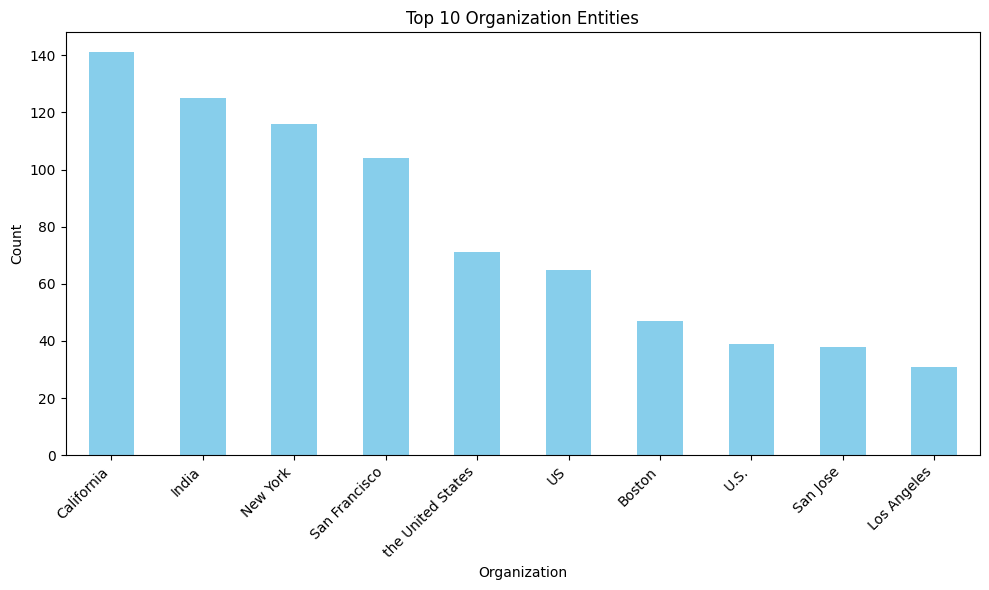

In [46]:
# Plot frequency count for top 10 selected entity type eg. Organisation 


import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
top_10_orgs.plot(kind='bar', color='skyblue')
plt.xlabel('Organization')
plt.ylabel('Count')
plt.title('Top 10 Organization Entities')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Save the plot
plt.savefig('top_10_people.png', format='png', dpi=300)  # You can specify the file format and DPI as needed

# Show the plot
plt.show()

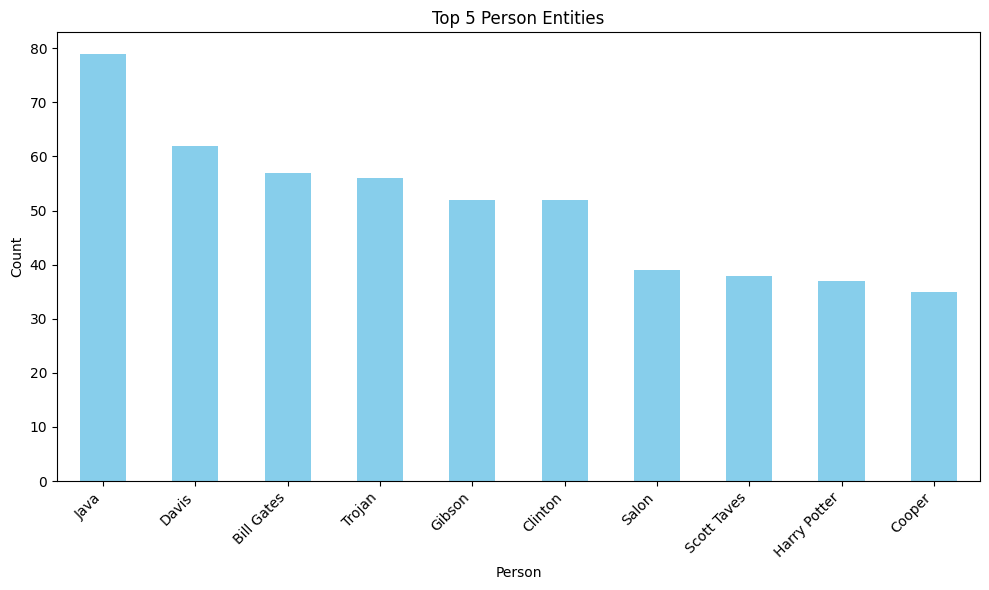

In [76]:
filename = 'ner_results.csv'  # Replace with your filename
df = pd.read_csv(filename)

# Filter rows where the label is 'PERSON'
person_df = df[df['Label'] == 'PERSON']

# Count the occurrences of each person entity
person_counts = person_df['Entity'].value_counts()

# Get the top 5 most frequent entities
top_5_persons = person_counts.nlargest(10)

# Create a figure and axis
plt.figure(figsize=(10, 6))

# Plot the results for the top 5 entities
top_5_persons.plot(kind='bar', color='skyblue')
plt.xlabel('Person')
plt.ylabel('Count')
plt.title('Top 5 Person Entities')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Save the figure to a file
output_filename = 'top_5_person_entities_culture.png'  # Replace with your desired filename
plt.savefig(output_filename)

# Show the plot
plt.show()

In [42]:
import plotly.io as pio


# Plot and save similarity matrix heatmap for topic categories 

# further analysis for first major category online active 
Online_activity = [11, 61, 11, 8, 4, 103, 1, 9, 97, 63, 38, 33, 22, 69]



heatmap_fig = multi_topic_model.visualize_heatmap(topics=Silicon_valley)

#heatmap_fig.write_html('cyber_heatmap_visualization.html', auto_open=True)

heatmap_fig.update_coloraxes(colorbar_x=1.1)  # Moves the color bar further right

# Adjust the size of the plot for better readability
heatmap_fig.update_layout(width=900, height=800)

# Display the modified figure
heatmap_fig.show()


In [24]:
multi_topic_model.visualize_barchart(topics=techcompanies)


In [72]:
representation_type = 'POS' 
Online_activity = [11, 61, 8, 4, 103, 1, 9, 97, 63, 38, 33, 22, 69]
topic_aspects = multi_topic_model.topic_aspects_

data = []

# Extract the topic representations for the selected topics
for topic_id in culture:
    try:
        # Access the specific representation for the topic
        representation = topic_aspects[representation_type][topic_id]
        
        # Extract terms and their scores as a list of tuples
        terms_scores = [(term, score) for term, score in representation]
        
        # Optionally, you can join terms with their scores as a string
        # terms_scores_str = ", ".join([f"{term}:{score:.4f}" for term, score in terms_scores])
        
        # Append the data as a dictionary with Topic ID and the combined terms-scores
        data.append({
            'Topic ID': topic_id,
            'Terms': [term for term, score in terms_scores],  # List of terms
            'Scores': [score for term, score in terms_scores]  # List of scores
        })
    except KeyError:
        print(f"Topic ID {topic_id} or representation type {representation_type} not found.")

# Convert the list of dictionaries to a DataFrame
culturedf = pd.DataFrame(data)

# Display the DataFrame
print(culturedf)

culturedf.to_csv('culture_representations_POS.csv', index=False)


    Topic ID                                              Terms  \
0         51  [writer, freelance, editor, lives, author, wee...   
1        129  [comics, comic, comix, cartoonists, crumb, str...   
2         24  [art, museum, artists, artist, exhibition, gal...   
3        107  [bookshelves, book, outta, reading, novel, thi...   
4         29  [intelligence, artificial, human, science, con...   
5         19  [rants, article, bits, page, date, raves, bulb...   
6         83  [adult, playboy, porn, sex, kitty, site, sites...   
7         71  [newspaper, newspapers, readers, editorial, pa...   
8         90  [journalism, journalists, media, moral, violen...   
9         34  [books, book, authors, publishing, publishers,...   
10        53  [patch, security, hole, bug, malicious, vulner...   

                                               Scores  
0   [0.39569274714667135, 0.3457472535684162, 0.32...  
1   [0.6702891624928669, 0.47950576428053265, 0.28...  
2   [0.36160206469347983, 0

In [23]:
china =[121,66,110]
culture = [51, 129, 24, 107, 29, 19, 83, 71, 90, 34, 53]
Silicon_valley = [92,80, 64]
Online_activity = [11, 61, 11, 8, 4, 103, 1, 9, 97, 63, 38, 33, 22, 69]
cybersecurity = [32, 5, 16, 15, 14, 6, 13, 10, 53, 42, 88, 39, 119, 105, 95]
techcompanies = [127, 130, 37, 3, 124, 27, 46, 118]
stock = [100, 94, 23, 25, 114, 28, 12, 0, 101]

In [26]:
topic_info_df = multi_topic_model.get_topic_info()


In [58]:
# Filter topic information by selected representation 

filtered_df = topic_info_df[topic_info_df['Topic'].isin(china)]


In [59]:
mmr_terms = filtered_df[['Topic', 'MMR']]
pos_terms = filtered_df[['Topic', 'POS']]
keybert_terms = filtered_df[['Topic', 'Keybert']]

In [60]:
pos_terms

,Topic,POS
67,66,"[mainland, foreign, handover, communist, gover..."
111,110,"[dissidents, unblocked, rights, fijilive, cafe..."
122,121,"[trade, relations, deficit, exiled, strait, fo..."


In [61]:
output_path = 'china_filtered_pos_representations.csv'

# Save the DataFrame to a CSV file
pos_terms.to_csv(output_path, index=False)

In [107]:
combined_terms = {}

for _, row in filtered_df.iterrows():
    topic_id = row['Topic']
    mmr_terms = row['MMR']
    pos_terms = row['POS']
    keybert_terms = row['Keybert']
    
    # Combine terms and convert to a set to get unique terms
    all_terms = set(mmr_terms + pos_terms + keybert_terms)
    combined_terms[topic_id] = list(all_terms)

In [108]:
combined_terms_df = pd.DataFrame(list(combined_terms.items()), columns=['Topic', 'Combined_Terms'])


In [110]:
combined_terms_df
combined_terms_df.to_csv('combined_terms.csv', index=False)


In [106]:
combined_terms_df

,Topic,Combined_Terms
0,53,"[Topic, MMR, POS, Keybert]"


In [91]:
example_topic_id = list(multi_topic_model.topic_aspects_.keys())[0]
print(f"Example content for topic ID {example_topic_id}: {multi_topic_model.topic_aspects_[example_topic_id]}")

Example content for topic ID Keybert: {-1: [('web', 0.8689662), ('net', 0.866395), ('cable', 0.86251324), ('network', 0.859414), ('media', 0.84888506), ('news', 0.84873843), ('business', 0.8454042), ('customers', 0.84249574), ('online', 0.8423006), ('access', 0.8406334)], 0: [('nasdaq', 0.86570907), ('stocks', 0.8551222), ('stock', 0.85020965), ('investors', 0.84059376), ('traders', 0.83906144), ('dow', 0.83645964), ('trading', 0.8263935), ('tech', 0.82441926), ('ftse', 0.8231728), ('earnings', 0.82310355)], 1: [('riaa', 0.89971817), ('napster', 0.8898972), ('mp3s', 0.88722026), ('mp3', 0.88588905), ('musicnet', 0.84805334), ('musicmatch', 0.8431807), ('copyrighted', 0.841864), ('piracy', 0.8409083), ('audio', 0.8349275), ('cds', 0.8304621)], 2: [('mars', 0.9146098), ('nasa', 0.9129698), ('martian', 0.8927064), ('spacecraft', 0.88464934), ('planetary', 0.8667029), ('astronauts', 0.86208457), ('space', 0.85850805), ('astronaut', 0.84830827), ('aerospace', 0.8474346), ('exploration', 0.8

In [40]:
largedf = pd.DataFrame({"Document": df['text_content'], "Topic": topics, "Year": df['year']})

largedf['Year'] = largedf['Year'].astype(int)

In [41]:
# Convert topics over time using Years column from original dataframe


topics_over_time = multi_topic_model.topics_over_time(
    docs=largedf['Document'].tolist(),  # List of documents
    timestamps=largedf['Year'].tolist()  # Corresponding years
)

9it [00:26,  2.99s/it]


In [43]:
tech_time = multi_topic_model.visualize_topics_over_time(topics_over_time, topics= techcompanies)

In [44]:
tech_time

In [39]:
multi_topic_model.get_topic_info()

,Topic,Count,Name,Representation,Keybert,POS,MMR,Representative_Docs
0,-1,2085,-1_br_his_the_in,"[br, his, the, in, com, of, and, was, for, to]","[web, net, cable, network, media, news, busine...","[cable, site, media, world, old, information, ...","[net, cable, media, business, customers, onlin...","[Macromedia, mostly known as the creator of so..."
1,0,1570,0_16_percent_stocks_dow,"[16, percent, stocks, dow, index, nasdaq, poin...","[nasdaq, stocks, stock, investors, traders, do...","[index, stocks, points, composite, industrial,...","[nasdaq, traders, dow, ftse, analysts, dropped...","[The trading week ended on a slow note, with s..."
2,1,1162,1_music_mp3_napster_recording,"[music, mp3, napster, recording, labels, digit...","[riaa, napster, mp3s, mp3, musicnet, musicmatc...","[music, labels, recording, songs, files, artis...","[riaa, napster, mp3s, musicnet, copyrighted, p...",[While record-company execs wring their hands ...
3,2,870,2_space_nasa_satellite_earth,"[space, nasa, satellite, earth, iridium, mars,...","[mars, nasa, martian, spacecraft, planetary, a...","[space, iridium, satellite, earth, orbit, sate...","[mars, nasa, spacecraft, satellites, cosmonaut...",[Frustrated mission controllers failed again S...
4,3,913,3_microsoft_antitrust_court_justice,"[microsoft, antitrust, court, justice, case, j...","[microsoft, antitrust, windows, doj, redmond, ...","[antitrust, judge, windows, court, gates, depa...","[microsoft, antitrust, doj, lawsuit, illegally...",[The key events leading up to Monday's decisio...
...,...,...,...,...,...,...,...,...
130,129,75,129_comics_comic_book_marvel,"[comics, comic, book, marvel, mccloud, art, yo...","[comics, comicdom, comic, comix, comiclopedia,...","[comics, comic, comix, cartoonists, crumb, str...","[comics, comix, www, readership, anime, fantag...","[Any artistic form, be it a Gregorian chant or..."
131,130,54,130_oracle_ellison_database_software,"[oracle, ellison, database, software, nci, syb...","[oracle, ellison, oracle7, computers, oracle8,...","[database, 9i, servers, server, applications, ...","[oracle, servers, netcom, nctv, solution, comp...",[Larry Ellison is apparently smarting from Mic...
132,131,177,131_cable_tci_at_mediaone,"[cable, tci, at, mediaone, comcast, deal, bill...","[telecommunications, merger, telecom, telecomm...","[cable, wireless, distance, local, merger, sto...","[telecommunications, merger, comcast, teleglob...",[With its surprise acquisition of US cable-TV ...
133,132,47,132_language_translation_english_languages,"[language, translation, english, languages, kl...","[translation, translating, translators, transl...","[translation, language, languages, translators...","[translating, multilingual, linguists, esperan...",[Universal Translators- A look at the hubs for...


In [39]:
>>> similar_topics, similarity = multi_topic_model.find_topics("outsource", top_n=10)


In [40]:
>>> multi_topic_model.get_topic(similar_topics[0])


[('cable', 0.03297445221079633),
 ('tci', 0.022378279041232976),
 ('at', 0.014401991508688247),
 ('mediaone', 0.012226338516980769),
 ('comcast', 0.011544820854256156),
 ('deal', 0.011521281671828556),
 ('billion', 0.01110545494235822),
 ('company', 0.010524912067642112),
 ('services', 0.010158006343280254),
 ('communications', 0.01014284534409147)]

In [41]:
topic_ids = similar_topics  # Extracting topic IDs

# Print the topic IDs
print(topic_ids)

[131, 73, 64, 12, 39, 80, 22, 30, 114, 84]


In [99]:
pip install transformers torch


huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


Note: you may need to restart the kernel to use updated packages.


In [100]:
! pip install torch

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [111]:
# Conduct sentiment analysis using FinBERT model for documents under the financial stock market category


from transformers import BertTokenizer, BertForSequenceClassification
from transformers import pipeline

# Load FinBERT tokenizer and model
tokenizer = BertTokenizer.from_pretrained('yiyanghkust/finbert-tone')
model = BertForSequenceClassification.from_pretrained('yiyanghkust/finbert-tone')

# Create a pipeline for sentiment analysis
sentiment_analysis = pipeline('sentiment-analysis', model=model, tokenizer=tokenizer, device=0)

In [112]:
document_info = multi_topic_model.get_document_info(docs)

# Filter documents based on topic IDs
filtered_documents = document_info[document_info['Topic'].isin(stock)]

# Extract the texts of the filtered documents
texts_to_analyze = filtered_documents['Document'].tolist()

In [113]:
len(texts_to_analyze)

3640

In [130]:
from transformers import BertTokenizer, BertForSequenceClassification
from transformers import pipeline
import torch

def truncate_texts(texts, tokenizer, max_length=512):
    truncated_texts = []
    for text in texts:
        # Tokenize the text
        tokens = tokenizer.encode(text, truncation=True, max_length=max_length)
        # Decode tokens back to string
        truncated_text = tokenizer.decode(tokens, skip_special_tokens=True)
        truncated_texts.append(truncated_text)
    return truncated_texts

# Truncate texts to avoid exceeding max token length
texts_to_analyze_truncated = truncate_texts(texts_to_analyze, sentiment_analysis.tokenizer)

# Run sentiment analysis on truncated texts
sentiment_results = sentiment_analysis(texts_to_analyze_truncated)
print("Raw sentiment results:")

for result in sentiment_results:
    print(result)

# Prepare a DataFrame for filtered documents
filtered_documents = pd.DataFrame({
    'Document': texts_to_analyze_truncated
})

# Extract sentiment results
sentiments = []
positive_scores = []
negative_scores = []
neutral_scores = []

filtered_documents = pd.DataFrame({
    'Document': texts_to_analyze_truncated
})

# Extract sentiment results
sentiments = []
positive_scores = []
negative_scores = []
neutral_scores = []

for result in sentiment_results:
    # Initialize scores
    pos_score = neg_score = neu_score = 0.0
    
    # Check if result is a list of dictionaries
    if isinstance(result, list):
        for label_score in result:
            if isinstance(label_score, dict):
                label = label_score['label']
                score = label_score['score']
                
                if label == 'POSITIVE':
                    pos_score = score
                elif label == 'NEGATIVE':
                    neg_score = score
                elif label == 'NEUTRAL':
                    neu_score = score
    
    # Determine the overall sentiment
    sentiments.append('POSITIVE' if pos_score > max(neg_score, neu_score) else
                       'NEGATIVE' if neg_score > max(pos_score, neu_score) else
                       'NEUTRAL')
    positive_scores.append(pos_score)
    negative_scores.append(neg_score)
    neutral_scores.append(neu_score)

# Add sentiment results to the filtered documents DataFrame
filtered_documents['Sentiment'] = sentiments
filtered_documents['Positive Score'] = positive_scores
filtered_documents['Negative Score'] = negative_scores
filtered_documents['Neutral Score'] = neutral_scores

# display results
output_csv_path = 'filtered_documents_with_sentiment_scores.csv'

filtered_documents[['Document', 'Sentiment', 'Positive Score', 'Negative Score', 'Neutral Score']].to_csv(output_csv_path, index=False)

print(f"Data saved to {output_csv_path}")

Raw sentiment results:
{'label': 'Neutral', 'score': 0.9800400733947754}
{'label': 'Neutral', 'score': 0.9654605984687805}
{'label': 'Neutral', 'score': 0.9991884827613831}
{'label': 'Neutral', 'score': 0.9888193011283875}
{'label': 'Neutral', 'score': 0.9903988838195801}
{'label': 'Neutral', 'score': 0.9999847412109375}
{'label': 'Neutral', 'score': 0.967671275138855}
{'label': 'Negative', 'score': 0.9965754151344299}
{'label': 'Neutral', 'score': 0.9999608993530273}
{'label': 'Negative', 'score': 0.997215747833252}
{'label': 'Neutral', 'score': 0.9997902512550354}
{'label': 'Positive', 'score': 0.9999803304672241}
{'label': 'Positive', 'score': 0.8945889472961426}
{'label': 'Neutral', 'score': 0.9999760389328003}
{'label': 'Neutral', 'score': 0.9972151517868042}
{'label': 'Neutral', 'score': 0.9999805688858032}
{'label': 'Negative', 'score': 0.9961345195770264}
{'label': 'Neutral', 'score': 0.9641605019569397}
{'label': 'Negative', 'score': 0.9994328618049622}
{'label': 'Negative', '

In [131]:
if len(sentiment_results) != len(filtered_documents):
    raise ValueError("The number of sentiment results does not match the number of documents.")

# Create DataFrame for sentiment results
sentiment_df = pd.DataFrame(sentiment_results)

# Add document column for merging 
sentiment_df['Document'] = filtered_documents['Document']

# Merge the two dataframes
merged_df = pd.merge(filtered_documents, sentiment_df, on='Document', how='left')


merged_df = merged_df.rename(columns={
    'label': 'Sentiment Label',
    'score': 'Sentiment Score'
})

# Add Positive, Negative, and Neutral Score columns
merged_df['Positive Score'] = merged_df.apply(lambda row: row['Sentiment Score'] if row['Sentiment Label'] == 'Positive' else 0.0, axis=1)
merged_df['Negative Score'] = merged_df.apply(lambda row: row['Sentiment Score'] if row['Sentiment Label'] == 'Negative' else 0.0, axis=1)
merged_df['Neutral Score'] = merged_df.apply(lambda row: row['Sentiment Score'] if row['Sentiment Label'] == 'Neutral' else 0.0, axis=1)

# Print the DataFrame to verify
print(merged_df[['Document', 'Sentiment Label', 'Sentiment Score', 'Positive Score', 'Negative Score', 'Neutral Score']])

# Save the DataFrame to a CSV file
output_csv_path = 'filtered_documents_with_sentiment_scores.csv'
merged_df.to_csv(output_csv_path, index=False)

print(f"Data saved to {output_csv_path}")

                                               Document Sentiment Label  \
0     san jose, california - - high - tech giant hew...         Neutral   
1     san jose, california - - high - tech giant hew...         Neutral   
2     motorola has developed a computer chip that co...         Neutral   
3     ever since sales of personal computers began t...         Neutral   
4     " at this very moment in time, like humankind ...         Neutral   
...                                                 ...             ...   
3641  how much does it cost to use media today? try ...         Neutral   
3642  in making acer a global computer brand current...         Neutral   
3643  suppose you could discern market trends, speed...         Neutral   
3644  the untold story of how sony is rapidly becomi...         Neutral   
3645  most japanese firms run with the pack. not can...         Neutral   

      Sentiment Score  Positive Score  Negative Score  Neutral Score  
0            0.980040       

In [136]:
! pip install seaborn

     |████████████████████████████████| 294 kB 3.5 MB/s eta 0:00:01


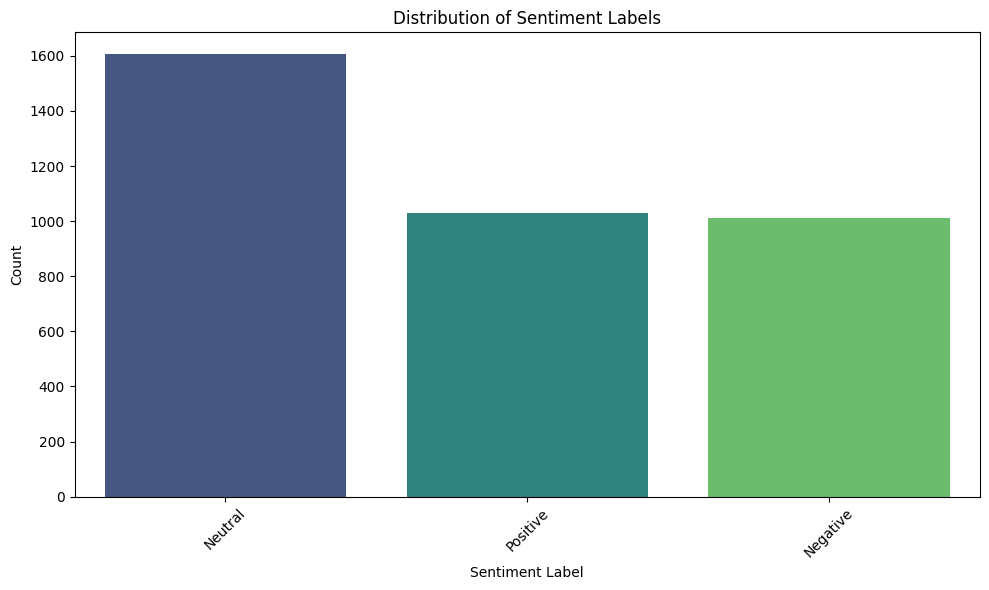

In [138]:
import matplotlib.pyplot as plt
import seaborn as sns

# Count occurrences of each sentiment label
sentiment_counts = merged_df['Sentiment Label'].value_counts()

# Create a bar plot
plt.figure(figsize=(10, 6))
sns.barplot(x=sentiment_counts.index, y=sentiment_counts.values, palette='viridis')

# Add labels and title
plt.xlabel('Sentiment Label')
plt.ylabel('Count')
plt.title('Distribution of Sentiment Labels')
plt.xticks(rotation=45)  # Rotate labels for better readability
output_img_path = 'sentiment_distribution.png'
plt.savefig(output_img_path)
# Display the plot
plt.tight_layout()
plt.show()

In [132]:
top_positive_docs = merged_df.sort_values(by='Positive Score', ascending=False).head(10)

# Get top 10 documents with highest negative scores
top_negative_docs = merged_df.sort_values(by='Negative Score', ascending=False).head(10)

# Print the results
print("Top 10 Documents with Highest Positive Scores:")
print(top_positive_docs[['Document', 'Positive Score']])

print("\nTop 10 Documents with Highest Negative Scores:")
print(top_negative_docs[['Document', 'Negative Score']])

Top 10 Documents with Highest Positive Scores:
                                               Document  Positive Score
1590  telecommunications equipment leader lucent tec...             1.0
2930  positive labor news provided a firm footing fo...             1.0
1988  ebay said on tuesday its fourth - quarter net ...             1.0
3097  mci communications'second - quarter profit fel...             1.0
1990  compaq computer, the world's biggest personal ...             1.0
3095  mci communications, the long - distance giant ...             1.0
2513  after so many stock - dragging earnings report...             1.0
2722  strong tech stocks pushed the nasdaq to anothe...             1.0
986   cisco systems again beat analyst forecasts, re...             1.0
669   new york - - u. s. stocks powered ahead tuesda...             1.0

Top 10 Documents with Highest Negative Scores:
                                               Document  Negative Score
455   sunnyvale, calif., dec 20 ( reuters

In [117]:
sentiment_counts = filtered_documents['Sentiment'].value_counts()

# Print the counts
print("Sentiment Counts:")
print(sentiment_counts)

# Optional: display results
print(filtered_documents[['Topic', 'Document', 'Sentiment']])

Sentiment Counts:
Sentiment
Neutral     1605
Positive    1028
Negative    1007
Name: count, dtype: int64
       Topic                                           Document Sentiment
31        28  SAN JOSE, California -- High-tech giant Hewlet...   Neutral
32        28  SAN JOSE, California -- High-tech giant Hewlet...   Neutral
36        28  Motorola has developed a computer chip that co...   Neutral
41        28  Ever since sales of personal computers began t...   Neutral
48        28  "At this very moment in time, like humankind 5...   Neutral
...      ...                                                ...       ...
31433      0  How much does it cost to use media today? Try ...   Neutral
31504     28  In making Acer a global computer brand current...   Neutral
31568     23  Suppose you could discern market trends, speed...   Neutral
31633     12  The untold story of how Sony is rapidly becomi...   Neutral
31815     28  Most Japanese firms run with the pack. Not Can...   Neutral

[3640 

In [124]:
print(df.columns)

# Check column names in the sentiment DataFrame
print(filtered_documents.columns)

Index(['title', 'year', 'summary', 'tag', 'text_content'], dtype='object')
Index(['Document', 'Topic', 'Name', 'Representation', 'Keybert', 'POS', 'MMR',
       'Representative_Docs', 'Top_n_words', 'Probability',
       'Representative_document', 'Sentiment'],
      dtype='object')


In [144]:
multi_topic_model.get_topic_info()

,Topic,Count,Name,Representation,Keybert,POS,MMR,Representative_Docs
0,-1,2085,-1_br_his_the_in,"[br, his, the, in, com, of, and, was, for, to]","[web, net, cable, network, media, news, busine...","[cable, site, media, world, old, information, ...","[net, cable, media, business, customers, onlin...","[Macromedia, mostly known as the creator of so..."
1,0,1570,0_16_percent_stocks_dow,"[16, percent, stocks, dow, index, nasdaq, poin...","[nasdaq, stocks, stock, investors, traders, do...","[index, stocks, points, composite, industrial,...","[nasdaq, traders, dow, ftse, analysts, dropped...","[The trading week ended on a slow note, with s..."
2,1,1162,1_music_mp3_napster_recording,"[music, mp3, napster, recording, labels, digit...","[riaa, napster, mp3s, mp3, musicnet, musicmatc...","[music, labels, recording, songs, files, artis...","[riaa, napster, mp3s, musicnet, copyrighted, p...",[While record-company execs wring their hands ...
3,2,870,2_space_nasa_satellite_earth,"[space, nasa, satellite, earth, iridium, mars,...","[mars, nasa, martian, spacecraft, planetary, a...","[space, iridium, satellite, earth, orbit, sate...","[mars, nasa, spacecraft, satellites, cosmonaut...",[Frustrated mission controllers failed again S...
4,3,913,3_microsoft_antitrust_court_justice,"[microsoft, antitrust, court, justice, case, j...","[microsoft, antitrust, windows, doj, redmond, ...","[antitrust, judge, windows, court, gates, depa...","[microsoft, antitrust, doj, lawsuit, illegally...",[The key events leading up to Monday's decisio...
...,...,...,...,...,...,...,...,...
130,129,75,129_comics_comic_book_marvel,"[comics, comic, book, marvel, mccloud, art, yo...","[comics, comicdom, comic, comix, comiclopedia,...","[comics, comic, comix, cartoonists, crumb, str...","[comics, comix, www, readership, anime, fantag...","[Any artistic form, be it a Gregorian chant or..."
131,130,54,130_oracle_ellison_database_software,"[oracle, ellison, database, software, nci, syb...","[oracle, ellison, oracle7, computers, oracle8,...","[database, 9i, servers, server, applications, ...","[oracle, servers, netcom, nctv, solution, comp...",[Larry Ellison is apparently smarting from Mic...
132,131,177,131_cable_tci_at_mediaone,"[cable, tci, at, mediaone, comcast, deal, bill...","[telecommunications, merger, telecom, telecomm...","[cable, wireless, distance, local, merger, sto...","[telecommunications, merger, comcast, teleglob...",[With its surprise acquisition of US cable-TV ...
133,132,47,132_language_translation_english_languages,"[language, translation, english, languages, kl...","[translation, translating, translators, transl...","[translation, language, languages, translators...","[translating, multilingual, linguists, esperan...",[Universal Translators- A look at the hubs for...


In [146]:
positive_docs = merged_df[merged_df['Sentiment Label'] == 'Positive']
negative_docs = merged_df[merged_df['Sentiment Label'] == 'Negative']

In [151]:
print(len(positive_docs))

1028


In [149]:
positive_docs_list = positive_docs['Document'].tolist()
negative_docs_list = negative_docs['Document'].tolist()

In [152]:
df_copy = df.copy()

# Rename the 'text_content' column to 'Document'
df_copy.rename(columns={'text_content': 'Document'}, inplace=True)

# Display the copied DataFrame with the renamed column
print(df_copy)

                                             title  year  \
0                                   Catching Waves  2001   
1             Playing God With the Handheld Market  2001   
2                                         Peerless  2001   
3                                New And Improved!  2001   
4                                Whiteboard Jungle  2001   
...                                            ...   ...   
32165                     Why do they call it 3DO?  1993   
32166                                 Bozo Filters  1993   
32167                  If Your Toaster Had a Brain  1993   
32168  Law and Disorder on the Electronic Frontier  1993   
32169                   Talk Back to Your TV? Not.  1993   

                                                 summary   tag  \
0      Haruki Nishijima collects analog electric wave...   NaN   
1      NET-BASED GAMING Think you could do a better j...  Gear   
2      HARDWARE The Gist: Data Dock $399.95 (with 20-...  Gear   
3      Is Chane

In [160]:
grouped_df

label,year


In [154]:
sentiment_df

,label,score,Document
0,Neutral,0.980040,"san jose, california - - high - tech giant hew..."
1,Neutral,0.965461,"san jose, california - - high - tech giant hew..."
2,Neutral,0.999188,motorola has developed a computer chip that co...
3,Neutral,0.988819,ever since sales of personal computers began t...
4,Neutral,0.990399,""" at this very moment in time, like humankind ..."
...,...,...,...
3635,Neutral,0.999994,how much does it cost to use media today? try ...
3636,Neutral,0.997664,in making acer a global computer brand current...
3637,Neutral,0.999925,"suppose you could discern market trends, speed..."
3638,Neutral,0.999995,the untold story of how sony is rapidly becomi...


In [161]:
print(positive_docs.head())
print(negative_docs.head())

                                             Document Sentiment  \
11  washington - - cheap financing for new cars tr...   NEUTRAL   
12  san jose, calif. - - fourth - quarter earnings...   NEUTRAL   
26  atlanta - - home depot inc. ( nyse : hd ), the...   NEUTRAL   
44  new york - - blue - chip stocks rose for a fif...   NEUTRAL   
50  new york - - amgen inc ( nasdaq : amgn ), the ...   NEUTRAL   

    Positive Score  Negative Score  Neutral Score Sentiment Label  \
11        0.999980             0.0            0.0        Positive   
12        0.894589             0.0            0.0        Positive   
26        0.993224             0.0            0.0        Positive   
44        0.524453             0.0            0.0        Positive   
50        1.000000             0.0            0.0        Positive   

    Sentiment Score  
11         0.999980  
12         0.894589  
26         0.993224  
44         0.524453  
50         1.000000  
                                             Docum

In [168]:
df_copy

,title,year,summary,tag,Document
0,Catching Waves,2001,Haruki Nishijima collects analog electric wave...,NaN,Haruki Nishijima collects analog electric wave...
1,Playing God With the Handheld Market,2001,NET-BASED GAMING Think you could do a better j...,Gear,NET-BASED GAMINGThink you could do a better jo...
2,Peerless,2001,HARDWARE The Gist: Data Dock $399.95 (with 20-...,Gear,HARDWAREThe Gist: Data Dock$399.95 (with 20-Gb...
3,New And Improved!,2001,Is Chanel totally you? By etching Coco’s signa...,NaN,Is Chanel totally you? By etching Coco's signa...
4,Whiteboard Jungle,2001,"HIGH TECH HIGH At a glance, the former warehou...",NaN,"HIGH TECH HIGHAt a glance, the former warehous..."
...,...,...,...,...,...
32165,Why do they call it 3DO?,1993,"OK kids, listen up. Nintendo is passe – who ca...",Gear,"OK kids, listen up. Nintendo is passe - who ca..."
32166,Bozo Filters,1993,"Every large, diverse group of people includes ...",Gear,"Every large, diverse group of people includes ..."
32167,If Your Toaster Had a Brain,1993,Echelon pushes chips for everything from train...,Gear,Echelon pushes chips for everything from train...
32168,Law and Disorder on the Electronic Frontier,1993,"""The Hacker Crackdown"" One morning in early 19...",Gear,"""The Hacker Crackdown""One morning in early 199..."


In [173]:
df

,title,year,summary,tag,text_content
0,Catching Waves,2001,Haruki Nishijima collects analog electric wave...,NaN,Haruki Nishijima collects analog electric wave...
1,Playing God With the Handheld Market,2001,NET-BASED GAMING Think you could do a better j...,Gear,NET-BASED GAMINGThink you could do a better jo...
2,Peerless,2001,HARDWARE The Gist: Data Dock $399.95 (with 20-...,Gear,HARDWAREThe Gist: Data Dock$399.95 (with 20-Gb...
3,New And Improved!,2001,Is Chanel totally you? By etching Coco’s signa...,NaN,Is Chanel totally you? By etching Coco's signa...
4,Whiteboard Jungle,2001,"HIGH TECH HIGH At a glance, the former warehou...",NaN,"HIGH TECH HIGHAt a glance, the former warehous..."
...,...,...,...,...,...
32165,Why do they call it 3DO?,1993,"OK kids, listen up. Nintendo is passe – who ca...",Gear,"OK kids, listen up. Nintendo is passe - who ca..."
32166,Bozo Filters,1993,"Every large, diverse group of people includes ...",Gear,"Every large, diverse group of people includes ..."
32167,If Your Toaster Had a Brain,1993,Echelon pushes chips for everything from train...,Gear,Echelon pushes chips for everything from train...
32168,Law and Disorder on the Electronic Frontier,1993,"""The Hacker Crackdown"" One morning in early 19...",Gear,"""The Hacker Crackdown""One morning in early 199..."


In [177]:
positive_docs


,Document,Sentiment,Positive Score,Negative Score,Neutral Score,Sentiment Label,Sentiment Score
11,washington - - cheap financing for new cars tr...,NEUTRAL,0.999980,0.0,0.0,Positive,0.999980
12,"san jose, calif. - - fourth - quarter earnings...",NEUTRAL,0.894589,0.0,0.0,Positive,0.894589
26,"atlanta - - home depot inc. ( nyse : hd ), the...",NEUTRAL,0.993224,0.0,0.0,Positive,0.993224
44,new york - - blue - chip stocks rose for a fif...,NEUTRAL,0.524453,0.0,0.0,Positive,0.524453
50,"new york - - amgen inc ( nasdaq : amgn ), the ...",NEUTRAL,1.000000,0.0,0.0,Positive,1.000000
...,...,...,...,...,...,...,...
3603,nations composing the majority of the world's ...,NEUTRAL,0.997705,0.0,0.0,Positive,0.997705
3614,"for years, brokers have been able to get real ...",NEUTRAL,0.977850,0.0,0.0,Positive,0.977850
3621,"follow the moneya chipper demandthis summer, t...",NEUTRAL,0.999547,0.0,0.0,Positive,0.999547
3622,follow the moneycooling the net hype iiin wire...,NEUTRAL,0.597304,0.0,0.0,Positive,0.597304


In [107]:
topic_to_category = {}

# Function to add topics to the mapping
def add_to_mapping(topics, category_name):
    for topic_id in topics:
        topic_to_category[topic_id] = category_name

# Add each category and its topics to the mapping
add_to_mapping(china, 'China')
add_to_mapping(culture, 'Culture')
add_to_mapping(Silicon_valley, 'Silicon Valley')
add_to_mapping(Online_activity , 'Online Activity')
add_to_mapping(cybersecurity, 'Cybersecurity')
add_to_mapping(techcompanies, 'Tech Companies')
add_to_mapping(stock, 'Stock')

In [94]:
print(topic_to_category)

{121: 'China', 66: 'China', 110: 'China', 51: 'Culture', 129: 'Culture', 24: 'Culture', 107: 'Culture', 29: 'Culture', 19: 'Culture', 83: 'Culture', 71: 'Culture', 90: 'Culture', 34: 'Culture', 53: 'Cybersecurity', 92: 'Silicon Valley', 80: 'Silicon Valley', 64: 'Silicon Valley', 11: 'Online Activity', 61: 'Online Activity', 8: 'Online Activity', 4: 'Online Activity', 103: 'Online Activity', 1: 'Online Activity', 9: 'Online Activity', 97: 'Online Activity', 63: 'Online Activity', 38: 'Online Activity', 33: 'Online Activity', 22: 'Online Activity', 69: 'Online Activity', 32: 'Cybersecurity', 5: 'Cybersecurity', 16: 'Cybersecurity', 15: 'Cybersecurity', 14: 'Cybersecurity', 6: 'Cybersecurity', 13: 'Cybersecurity', 10: 'Cybersecurity', 42: 'Cybersecurity', 88: 'Cybersecurity', 39: 'Cybersecurity', 119: 'Cybersecurity', 105: 'Cybersecurity', 95: 'Cybersecurity', 127: 'Tech Companies', 130: 'Tech Companies', 37: 'Tech Companies', 3: 'Tech Companies', 124: 'Tech Companies', 27: 'Tech Compani

In [104]:
document_info = multi_topic_model.get_document_info(docs)


In [102]:
document_info


,Document,Topic,Name,Representation,Keybert,POS,MMR,Representative_Docs,Top_n_words,Probability,Representative_document
0,Haruki Nishijima collects analog electric wave...,24,24_art_museum_artists_artist,"[art, museum, artists, artist, of, and, the, w...","[art, curator, curators, artmuseum, exhibition...","[art, museum, artists, artist, exhibition, gal...","[curator, artmuseum, exhibitions, arts, guggen...",[SAN FRANCISCO -- Benjamin Weil is somewhat of...,art - museum - artists - artist - of - and - t...,0.000000,False
1,NET-BASED GAMINGThink you could do a better jo...,4,4_game_games_gaming_you,"[game, games, gaming, you, and, sega, the, pla...","[videogames, consoles, gaming, videogame, xbox...","[game, games, gaming, gamers, console, players...","[videogames, activision, segasoft, dreamcast, ...",[LOS ANGELES -- The contrast between Sega's ea...,game - games - gaming - you - and - sega - the...,0.736909,False
2,HARDWAREThe Gist: Data Dock$399.95 (with 20-Gb...,126,126_dvd_video_divx_cd,"[dvd, video, divx, cd, players, disc, format, ...","[dvd, dvds, videodisc, discs, vhs, vcrs, dvr, ...","[discs, players, video, disc, format, drives, ...","[dvds, videodisc, vhs, dvr, electronics, recor...","[RANCHO MIRAGE, California �- DVD as a home-vi...",dvd - video - divx - cd - players - disc - for...,0.000000,False
3,Is Chanel totally you? By etching Coco's signa...,-1,-1_br_his_the_in,"[br, his, the, in, com, of, and, was, for, to]","[web, net, cable, network, media, news, busine...","[cable, site, media, world, old, information, ...","[net, cable, media, business, customers, onlin...","[Macromedia, mostly known as the creator of so...",br - his - the - in - com - of - and - was - f...,0.000000,False
4,"HIGH TECH HIGHAt a glance, the former warehous...",16,16_students_school_schools_education,"[students, school, schools, education, teacher...","[classrooms, educators, teachers, schools, tea...","[students, teachers, schools, education, schoo...","[classrooms, educators, technology, thinkquest...",[CHICAGO –- They spend nine months out of the ...,students - school - schools - education - teac...,0.680319,False
...,...,...,...,...,...,...,...,...,...,...,...
32165,"OK kids, listen up. Nintendo is passe - who ca...",4,4_game_games_gaming_you,"[game, games, gaming, you, and, sega, the, pla...","[videogames, consoles, gaming, videogame, xbox...","[game, games, gaming, gamers, console, players...","[videogames, activision, segasoft, dreamcast, ...",[LOS ANGELES -- The contrast between Sega's ea...,game - games - gaming - you - and - sega - the...,0.789245,False
32166,"Every large, diverse group of people includes ...",14,14_privacy_information_data_that,"[privacy, information, data, that, to, the, of...","[privacy, ftc, anonymous, policy, regulation, ...","[privacy, cookies, regulation, personal, infor...","[privacy, ftc, anonymous, protections, consume...","[In a new report released Tuesday, a leading c...",privacy - information - data - that - to - the...,0.000000,False
32167,Echelon pushes chips for everything from train...,9,9_apple_mac_jobs_os,"[apple, mac, jobs, os, imac, macintosh, the, m...","[macworld, apple, macintosh, imacs, macs, mac,...","[apple, jobs, developers, ibook, operating, ke...","[macworld, imac, macweek, ibook, itunes, power...",[Apple Computer on Wednesday reported higher-t...,apple - mac - jobs - os - imac - macintosh - t...,0.000000,False
32168,"""The Hacker Crackdown""One morning in early 199...",6,6_fbi_security_hackers_computer,"[fbi, security, hackers, computer, the, said, ...","[fbi, wiretap, wiretaps, terrorism, wiretappin...","[hackers, hacker, attacks, security, hacking, ...","[fbi, wiretaps, surveillance, liberties, congr...",[WASHINGTON -- Legislators who sent a sweeping...,fbi - security - hackers - computer - the - sa...,0.000000,False


In [108]:
print(topic_to_category)

{121: 'China', 66: 'China', 110: 'China', 51: 'Culture', 129: 'Culture', 24: 'Culture', 107: 'Culture', 29: 'Culture', 19: 'Culture', 83: 'Culture', 71: 'Culture', 90: 'Culture', 34: 'Culture', 53: 'Cybersecurity', 92: 'Silicon Valley', 80: 'Silicon Valley', 64: 'Silicon Valley', 11: 'Online Activity', 61: 'Online Activity', 8: 'Online Activity', 4: 'Online Activity', 103: 'Online Activity', 1: 'Online Activity', 9: 'Online Activity', 97: 'Online Activity', 63: 'Online Activity', 38: 'Online Activity', 33: 'Online Activity', 22: 'Online Activity', 69: 'Online Activity', 32: 'Cybersecurity', 5: 'Cybersecurity', 16: 'Cybersecurity', 15: 'Cybersecurity', 14: 'Cybersecurity', 6: 'Cybersecurity', 13: 'Cybersecurity', 10: 'Cybersecurity', 42: 'Cybersecurity', 88: 'Cybersecurity', 39: 'Cybersecurity', 119: 'Cybersecurity', 105: 'Cybersecurity', 95: 'Cybersecurity', 127: 'Tech Companies', 130: 'Tech Companies', 37: 'Tech Companies', 3: 'Tech Companies', 124: 'Tech Companies', 27: 'Tech Compani

In [111]:
document_info['Category'] = document_info['Topic'].map(topic_to_category)


In [112]:
print(document_info)

                                                Document  Topic  \
0      Haruki Nishijima collects analog electric wave...     24   
1      NET-BASED GAMINGThink you could do a better jo...      4   
2      HARDWAREThe Gist: Data Dock$399.95 (with 20-Gb...    126   
3      Is Chanel totally you? By etching Coco's signa...     -1   
4      HIGH TECH HIGHAt a glance, the former warehous...     16   
...                                                  ...    ...   
32165  OK kids, listen up. Nintendo is passe - who ca...      4   
32166  Every large, diverse group of people includes ...     14   
32167  Echelon pushes chips for everything from train...      9   
32168  "The Hacker Crackdown"One morning in early 199...      6   
32169  Dan Ruby and Dan LavinInteractive NetworkFutur...      8   

                                       Name  \
0              24_art_museum_artists_artist   
1                   4_game_games_gaming_you   
2                     126_dvd_video_divx_cd   
3      

In [113]:
document_info['Category'].fillna('Unlabeled', inplace=True)


In [114]:
import plotly.express as px


In [115]:
df_plot = pd.DataFrame({
    'x': reduced_embeddings[:, 0],   # First component of UMAP
    'y': reduced_embeddings[:, 1],   # Second component of UMAP
    'Category': document_info['Category']  # Category labels for each document
})

In [122]:
fig = px.scatter(
    df_plot, x='x', y='y',
    color='Category',                # Color by category
    color_discrete_map={  # Specify colors for each category
        'China': 'red',
        'Culture': 'blue',
        'Silicon Valley': 'green',
        'Online Activity': 'purple',
        'Cybersecurity': 'orange',
        'Tech Companies': 'cyan',
        'Stock': 'magenta',
        'Unlabeled': 'gray'  # Color for unlabeled points
    },
    title="UMAP Visualization of Documents by Category",
    template="plotly_dark",  # Use a dark background
    width=1000,              # Set width
    height=1200               # Set height
)

# Save the interactive plot as an HTML file
fig.write_html("umap_visualization.html")

# Show the plot
fig.show()

In [123]:
category_counts = pd.Series(topic_to_category.values()).value_counts().sort_index()

# Step 2: Create a DataFrame for Plotly
df_plot = pd.DataFrame({
    'Category': category_counts.index,
    'Count': category_counts.values
})

# Step 3: Create a horizontal bar chart using Plotly
fig = px.bar(
    df_plot, x='Count', y='Category',
    orientation='h',  # Horizontal bar chart
    title="Number of Topics in Each Category",
    labels={'Count': 'Number of Topics', 'Category': 'Category'},
    template="plotly_white"  # Light theme for better visibility
)

# Update the layout to make the legend bigger and improve readability
fig.update_layout(
    xaxis=dict(title='Number of Topics', title_font=dict(size=18)),
    yaxis=dict(title='Category', title_font=dict(size=18)),
    margin=dict(l=100, r=50, t=50, b=50),  # Adjust margins for better space usage
)

# Show the plot
fig.show()

# Save the plot as an HTML file
fig.write_html("topics_per_category_bar_chart.html")